<center><img src="https://github.com/hse-ds/iad-applied-ds/blob/master/2021/hw/hw1/img/logo_hse.png?raw=1" width="1000"></center>

<h1><center>Прогнозирование временных рядов</center></h1>

In [1]:
# !pip install -r requirements.txt

In [2]:
import warnings
import gdown
import pandas as pd
import numpy as np
import seaborn as sns
from copy import deepcopy

warnings.filterwarnings("ignore")

В данной задаче мы будем решать одну из актуальных практических задач работы с временными рядами — прогнозирование объема необходимой наличности в банкоматах (на примере одного устройства). 

Пожалуй, ни для кого не секрет, что отсутствие необходимой суммы в банкомате не делает клиента банка счастливее. В то же время, избыток заправленной в банкомат наличности приводит к упущенной выгоде — ведь, в конечном счете, эти деньги могли быть размещены в качестве краткосрочного депозита на межбанковском рынке. Для кредитной организации с обширной сетью банкоматов даже незначительное улучшение качества предсказания способно внести значительный вклад в прибыльность этой ветки бизнеса. 

Мы будем использовать дневные данные реального банкомата хоть и не с российского рынка, но очень схожего с ним — турецкого. Скачаем и загрузим их:

In [ ]:
url = 'https://raw.githubusercontent.com/andrei-egorov/ml_se_seminars/master/atm_daily_cash.csv'
output = 'atm_daily_cash.csv'
gdown.download(url=url, output=output, quiet=False, fuzzy=True)

df = pd.read_csv('atm_daily_cash.csv')
df = df[4:]  # лучше избавиться от нескольких пропущенных значений в начале сразу,
             # они могут доставлять ненужные лишние проблемы

Downloading...
From: https://raw.githubusercontent.com/andrei-egorov/ml_se_seminars/master/atm_daily_cash.csv
To: /content/atm_daily_cash.csv
26.1kB [00:00, 5.01MB/s]                   


Посмотрим, что представляют из себя данные:

In [4]:
df.head()

,Date,CashIn,CashOut
4,1/5/2016,20840.0,22200.0
5,1/6/2016,28460.0,18810.0
6,1/7/2016,19250.0,23210.0
7,1/8/2016,49770.0,4350.0
8,1/9/2016,NaN,NaN


В нашем распоряжении **пополнения и изъятия**; нас интересует **нетто**. Для этого будем учитывать изъятия со знаком минус, а нетто определим как сумму (такое представление пригодится нам в дальнейшем).

In [230]:
df['CashOut'] = -df['CashOut']
df['netto'] = df['CashIn'] + df['CashOut']

### EDA

Проведем разведывательный анализ данных — построим графики, на которых можно судить о наличии тренда, сезонности и прочих зависимостей. Проанализируем корреляции. 

Попробуем сделать предварительные выводы.

In [6]:
# основные библиотеки
import os
import random

import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd

from tqdm.notebook import tqdm
from IPython.display import clear_output

In [7]:
# визуализация

sns.set(style='darkgrid', palette='deep')
plt.rcParams['font.size'] = 12
plt.rcParams['figure.figsize'] = 8, 5
plt.rcParams['savefig.format'] = 'pdf'

%matplotlib inline
%config InlineBackend.figure_format = 'retina'

Описательные статистики и пропуски:

In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1182 entries, 4 to 1185
Data columns (total 4 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   Date     1182 non-null   object 
 1   CashIn   1081 non-null   float64
 2   CashOut  1094 non-null   float64
 3   netto    1072 non-null   float64
dtypes: float64(3), object(1)
memory usage: 37.1+ KB


In [9]:
for i in range(len(df.isna().sum())):
    print(f'В столбце {df.columns[i]} пропусков: {df.isna().sum()[i]} ({df.isna().sum()[i] / df.shape[0] * 100:.2f}%)')

В столбце Date пропусков: 0 (0.00%)
В столбце CashIn пропусков: 101 (8.54%)
В столбце CashOut пропусков: 88 (7.45%)
В столбце netto пропусков: 110 (9.31%)


In [10]:
df.describe()  # описательные статистики

,CashIn,CashOut,netto
count,1081.000000,1094.000000,1072.000000
mean,37261.618871,-30985.648995,5976.651119
std,20583.186636,18314.048275,21551.659802
min,100.000000,-111700.000000,-75190.000000
25%,21690.000000,-40375.000000,-6277.500000
50%,34980.000000,-27895.000000,5320.000000
75%,50280.000000,-18010.000000,18515.000000
max,121300.000000,-0.000000,85160.000000


*Видно, что данные колеблятся около нуля с большим разбросом.*

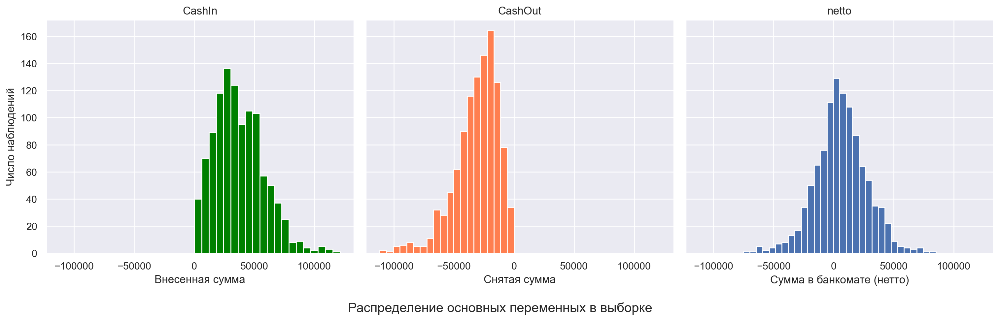

In [13]:
# гистограммы данных
f, ax1 = plt.subplots(1, 3, figsize=(17, 5.5), sharex=True, sharey=True)

ax1[0].hist(df['CashIn'], bins=20, color='green')
ax1[0].set_ylabel('Число наблюдений')
ax1[0].set_xlabel('Внесенная сумма')
ax1[0].set_title('CashIn')

ax1[1].hist(df['CashOut'], bins=20, color='coral')
ax1[1].set_ylabel('')
ax1[1].set_xlabel('Снятая сумма')
ax1[1].set_title('CashOut')

ax1[2].hist(df['netto'], bins=30)
ax1[2].set_ylabel('')
ax1[2].set_xlabel('Сумма в банкомате (нетто)')
ax1[2].set_title('netto')

f.suptitle("Распределение основных переменных в выборке", y=0.035)
f.tight_layout(rect=[0.05, 0.05, 0.95, 0.95])

Сумма двух сегментов `CashIn` и `CashOut`, судя по гистограмме, имеет нормальное распределение.

Приведем столбец `Date` к формату `datetime` из `object` и создадим вспомогательный датасет для визуализации данных по дням недели и месяцам:

In [14]:
df['timestamp'] = pd.to_datetime(df['Date'])
df = df.drop('Date', axis='columns')

# новый датасет
df_copy = df.copy(deep=True)
df_copy['day_of_week'] = df_copy['timestamp'].dt.day_of_week
df_copy['month_number'] = df_copy['timestamp'].dt.month

df_copy.head()

,CashIn,CashOut,netto,timestamp,day_of_week,month_number
4,20840.0,-22200.0,-1360.0,2016-01-05,1,1
5,28460.0,-18810.0,9650.0,2016-01-06,2,1
6,19250.0,-23210.0,-3960.0,2016-01-07,3,1
7,49770.0,-4350.0,45420.0,2016-01-08,4,1
8,NaN,NaN,NaN,2016-01-09,5,1


Посмотрим на имеющиеся временные ряды **по отдельности** и **на одном графике**:

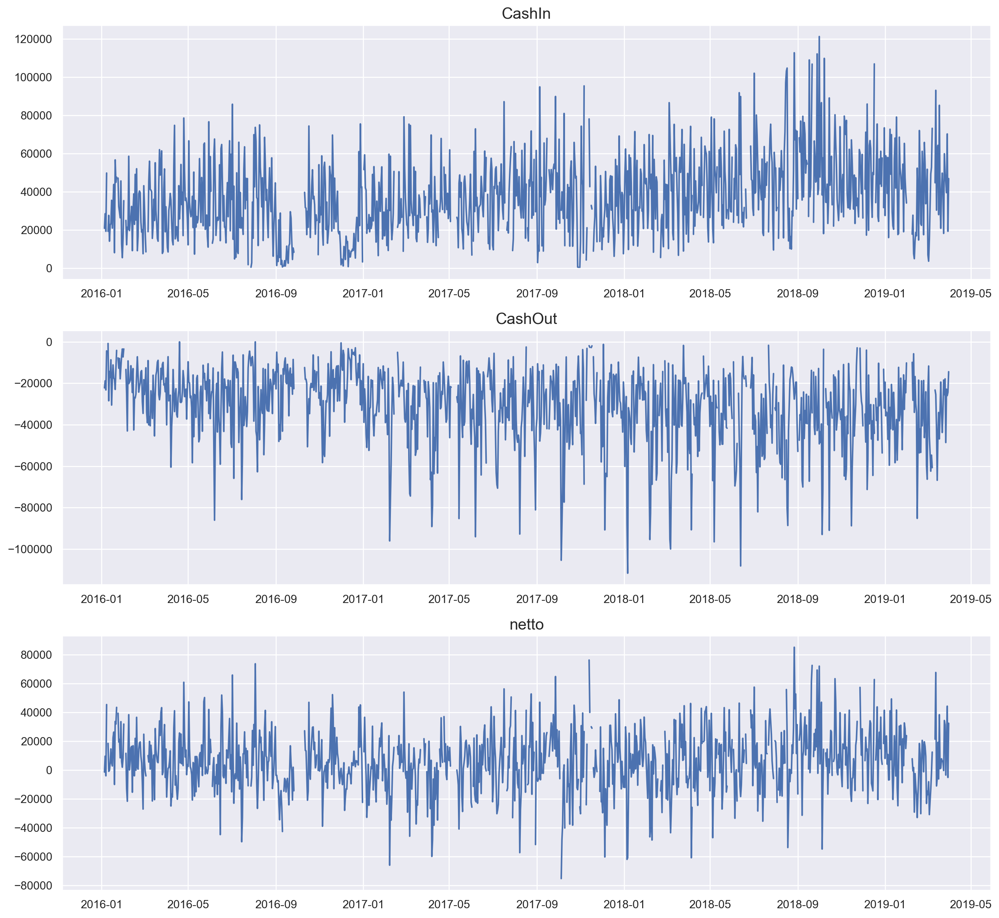

In [15]:
figsize = (16, 5)

figsize = (figsize[0] * 1, figsize[1] * 3)
_, ax = plt.subplots(3, 1, figsize=figsize, squeeze=False)
ax = ax.ravel()

names = ['CashIn', 'CashOut', 'netto']

for i in range(3):
    ax[i].plot(df['timestamp'], df[names[i]])
    ax[i].set_title(names[i], fontsize=15)

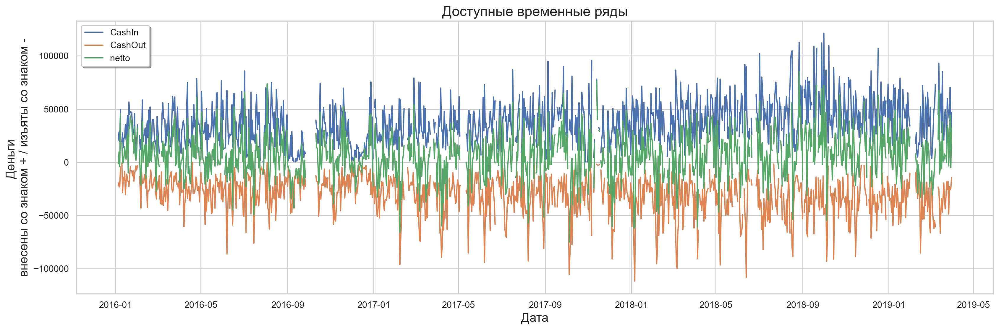

In [17]:
plt.figure(figsize=(20, 6), facecolor='white', edgecolor='white')
sns.set_style('whitegrid')

plt.plot(df['timestamp'], df['CashIn'], label='CashIn')
plt.plot(df['timestamp'], df['CashOut'], label='CashOut')
plt.plot(df['timestamp'], df['netto'], label='netto')

plt.legend(loc='best', shadow=True)
plt.title('Доступные временные ряды', fontsize=17)
plt.xlabel('Дата', fontsize=15)
plt.ylabel('Деньги \nвнесены со знаком + / изъяты со знаком -', fontsize=15)
plt.show()

sns.set(style='darkgrid', palette='deep')

На большом графике ряды сливаются из-за большого числа значений и шума. Посмотрим на **первые 500 дней** в данных:

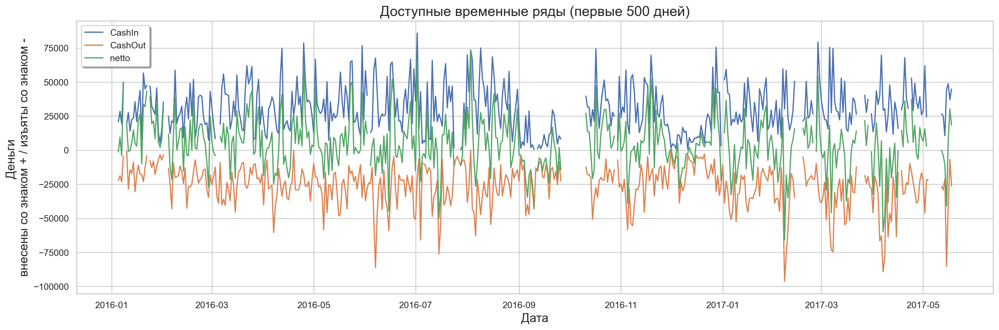

In [18]:
plt.figure(figsize=(20, 6), facecolor='white', edgecolor='white')
sns.set_style('whitegrid')

plt.plot(df['timestamp'][:500], df['CashIn'][:500], label='CashIn')
plt.plot(df['timestamp'][:500], df['CashOut'][:500], label='CashOut')
plt.plot(df['timestamp'][:500], df['netto'][:500], label='netto')

plt.legend(loc='best', shadow=True)
plt.title('Доступные временные ряды (первые 500 дней)', fontsize=17)
plt.xlabel('Дата', fontsize=15)
plt.ylabel('Деньги \nвнесены со знаком + / изъяты со знаком -', fontsize=15)
plt.show()

sns.set(style='darkgrid', palette='deep')

Дни **с 850 по 1100**: ближе к концу:

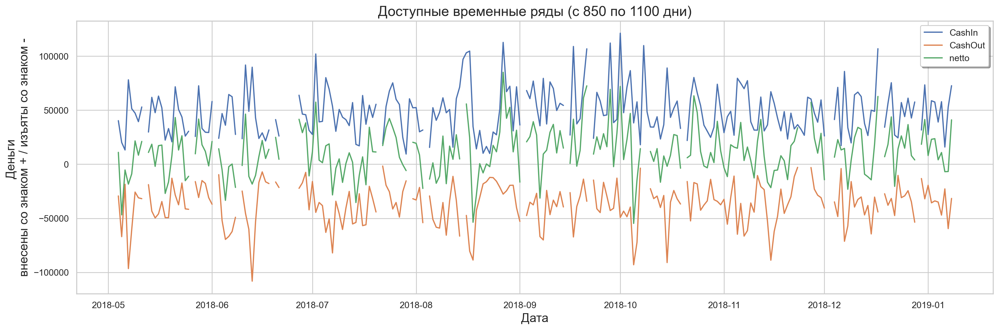

In [19]:
plt.figure(figsize=(20, 6), facecolor='white', edgecolor='white')
sns.set_style('whitegrid')

plt.plot(df['timestamp'][850:1100], df['CashIn'][850:1100], label='CashIn')
plt.plot(df['timestamp'][850:1100], df['CashOut'][850:1100], label='CashOut')
plt.plot(df['timestamp'][850:1100], df['netto'][850:1100], label='netto')

plt.legend(loc='best', shadow=True)
plt.title('Доступные временные ряды (с 850 по 1100 дни)', fontsize=17)
plt.xlabel('Дата', fontsize=15)
plt.ylabel('Деньги \nвнесены со знаком + / изъяты со знаком -', fontsize=15)
plt.show()

sns.set(style='darkgrid', palette='deep')

Можно заметить следующее:
* пропуски (разрывы) в данных,
* ярко выраженного тренда нет, возможно, только ближе к концу временного ряда, к тому же он нелинейный,
* ярко выраженная сезонность с четкой периодичностью,
* много шума

Посмотрим на зависимость рядов от значений дня недели и месяца:

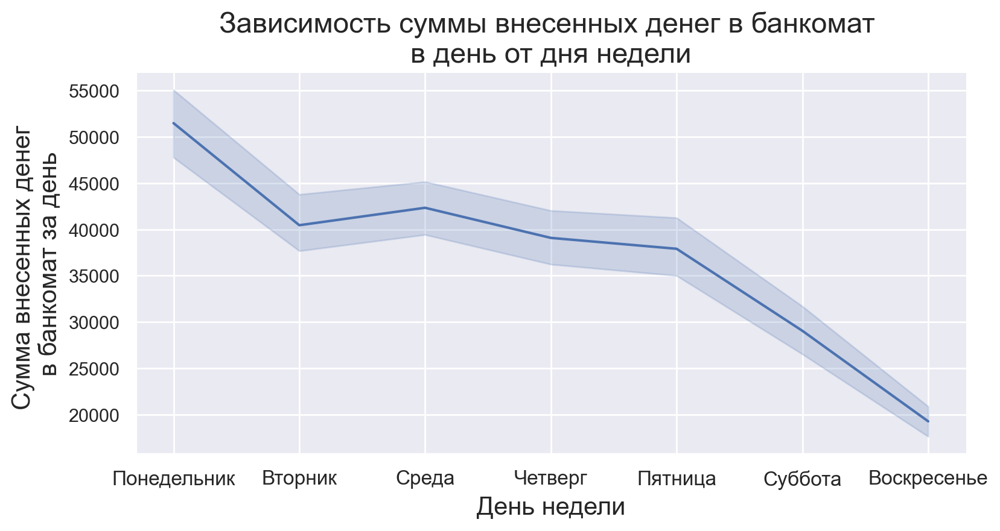

In [20]:
sns.relplot(x='day_of_week', 
            y='CashIn',
            kind='line',
            height=4,
            aspect=2,
            data=df_copy)

plt.title('Зависимость суммы внесенных денег в банкомат \nв день от дня недели', fontsize=17)

plt.xlabel('День недели', fontsize=15)
plt.ylabel('Сумма внесенных денег \nв банкомат за день', fontsize=15)
plt.xticks(np.arange(7), labels=['Понедельник', 'Вторник', 'Среда', 'Четверг', 'Пятница', 'Суббота', 'Воскресенье'], fontsize=12);

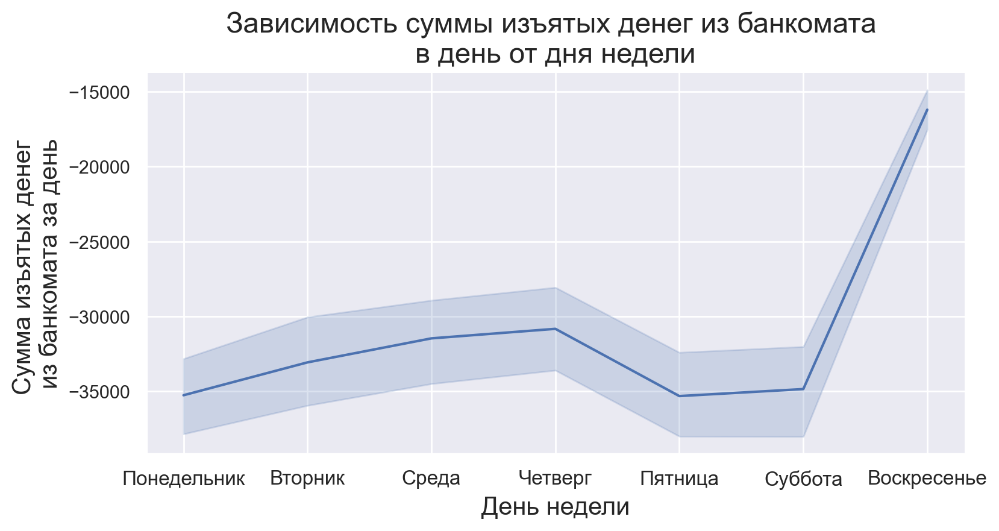

In [21]:
sns.relplot(x='day_of_week', 
            y='CashOut',
            kind='line',
            height=4,
            aspect=2,
            data=df_copy)

plt.title('Зависимость суммы изъятых денег из банкомата \nв день от дня недели', fontsize=17)

plt.xlabel('День недели', fontsize=15)
plt.ylabel('Сумма изъятых денег \nиз банкомата за день', fontsize=15)
plt.xticks(np.arange(7), labels=['Понедельник', 'Вторник', 'Среда', 'Четверг', 'Пятница', 'Суббота', 'Воскресенье'], fontsize=12);

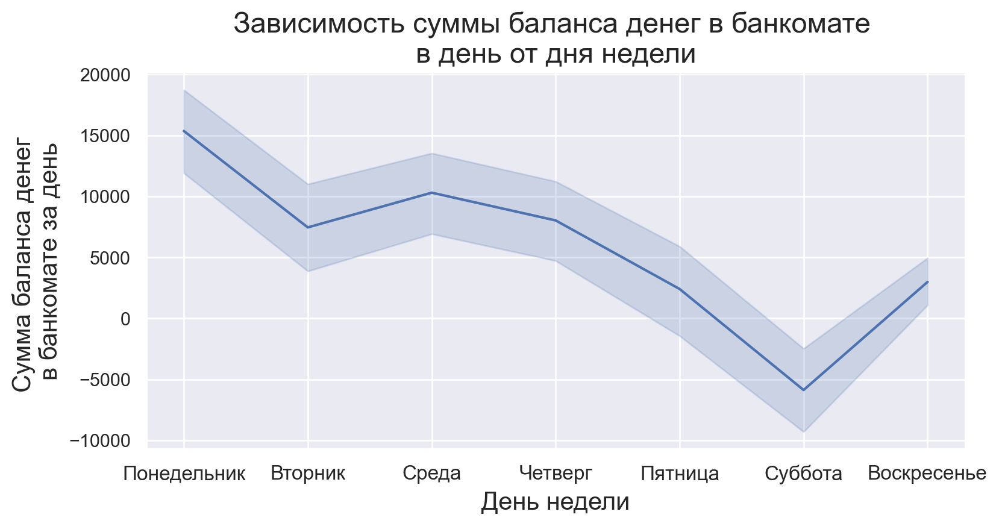

In [22]:
sns.relplot(x='day_of_week', 
            y='netto',
            kind='line',
            height=4,
            aspect=2,
            data=df_copy)

plt.title('Зависимость суммы баланса денег в банкомате \nв день от дня недели', fontsize=17)

plt.xlabel('День недели', fontsize=15)
plt.ylabel('Сумма баланса денег \nв банкомате за день', fontsize=15)
plt.xticks(np.arange(7), labels=['Понедельник', 'Вторник', 'Среда', 'Четверг', 'Пятница', 'Суббота', 'Воскресенье'], fontsize=12);

Видно, что день недели хорошо обуславливает сезонность в данных.

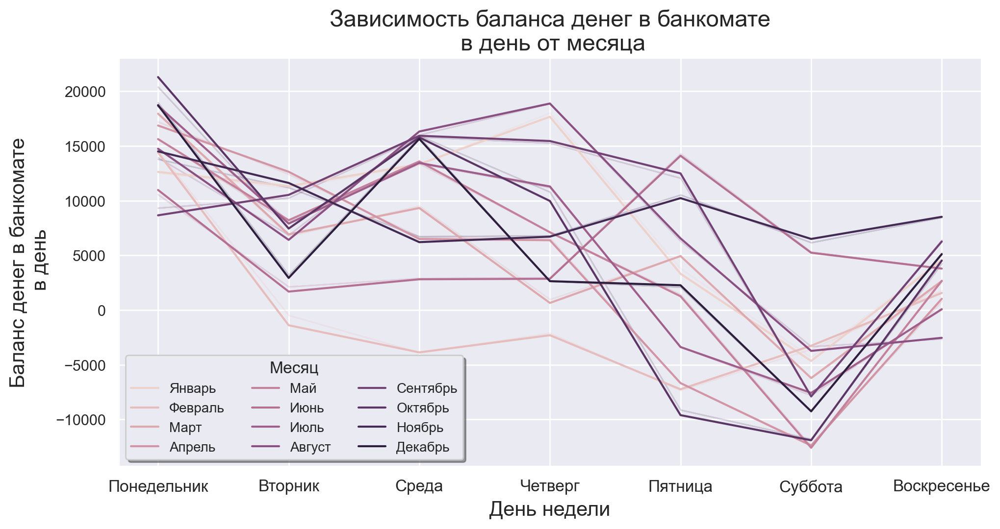

In [23]:
sns.relplot(x='day_of_week',
            y='netto',
            hue='month_number',
            legend=False,
            ci=False,
            kind='line',
            height=5,
            aspect=2,
            data=df_copy)

plt.title('Зависимость баланса денег в банкомате\n в день от месяца', fontsize=17)

plt.xlabel('День недели', fontsize=15)
plt.ylabel('Баланс денег в банкомате\n в день', fontsize=15)
plt.xticks(np.arange(7), labels=['Понедельник', 'Вторник', 'Среда', 'Четверг', 'Пятница', 'Суббота', 'Воскресенье'], fontsize=12);
plt.legend(title='Месяц', labels=['Январь', 'Февраль', 'Март', 'Апрель', 'Май', 'Июнь', 'Июль', 'Август', 'Сентябрь', 'Октябрь', 'Ноябрь', 'Декабрь'], 
           title_fontsize=12, fontsize=10, ncol=3, loc='best', shadow=True);

Месяц года не так хорошо объясняет таргет, но связь в связке с днем недели может объяснить часть информации.

Посмотрим на **статистические взаимосвязи** сегментов:

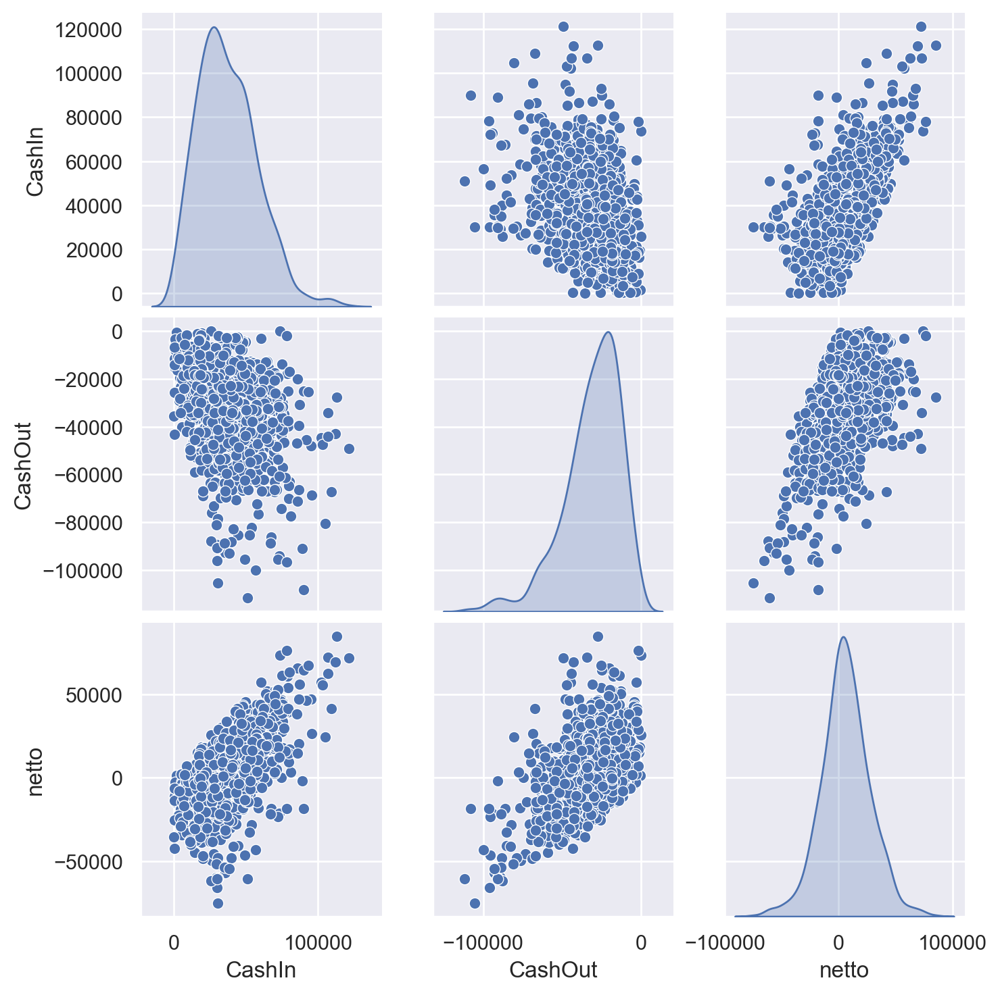

In [24]:
sns.pairplot(df, diag_kind="kde");

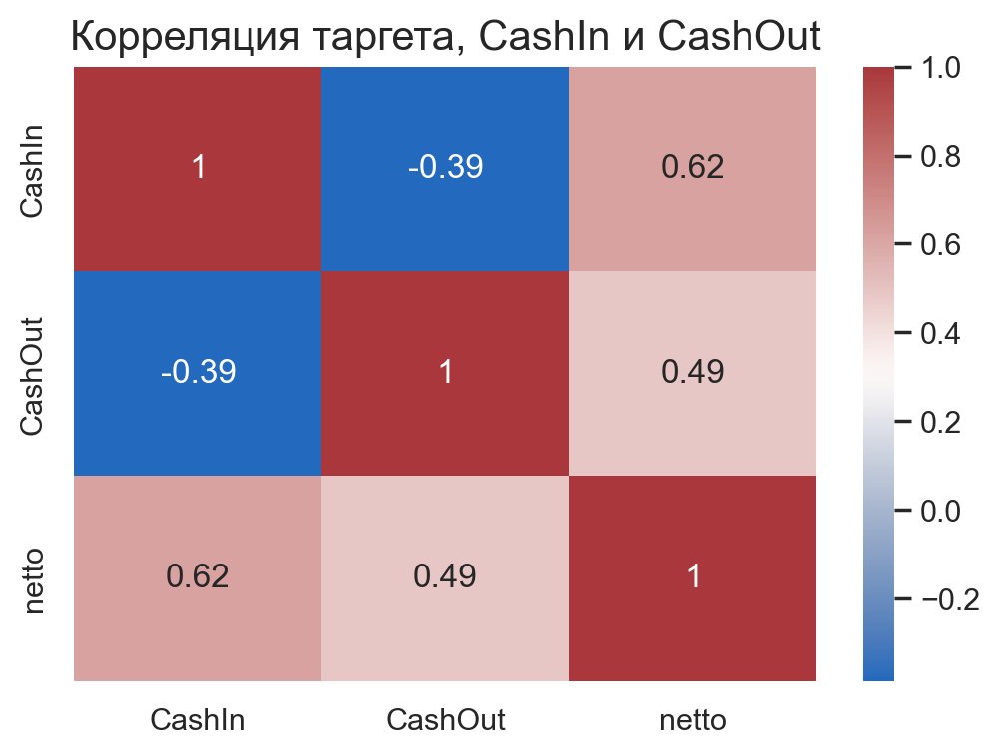

In [25]:
cmap = sns.color_palette("vlag", as_cmap=True)

fig, ax = plt.subplots(figsize=(6, 4))
ax = sns.heatmap(data=df.corr(), ax=ax, annot=True, cmap=cmap)
ax.set_title('Корреляция таргета, CashIn и CashOut', fontsize=15);

Между рядами есть довольно сильная линейная взаимосвязь.

**Выводы**:
* данные сложные — есть много пропусков (около 9%) и сильная сезонность (большая амплитуда)
    * сезонность, кажется, хорошо объясняется днем недели и месяцем года,
* тренд слабый, возможно, нелинейный и волнообразный,
* есть взаимосвязь между рядами,
* данные распределены практически нормально.

### Приведение в формат multi-segment

Теперь приведем данные к формату, в котором с ними будет возможно работать средствами библиотеки для временных рядов [`etna`](https://etna.tinkoff.ru/). 

Вначале мы будем рассматривать и предсказывать наши данные как мульти-сегментные. На выходе у нас должен получиться объект `TSDataset`. Поскольку мы будем смотреть на данные не только в этом разрезе, лучше не менять исходный датафрейм и работать с копией.

In [26]:
from etna.datasets import TSDataset
from etna.analysis import cross_corr_plot

In [232]:
# копируем изначальный датасет в pd.DataFrame формате
original_df = df.copy(deep=True)

In [233]:
df = pd.melt(df, id_vars=['timestamp'], value_vars=['CashIn', 'CashOut', 'netto'], var_name='segment', value_name='target', ignore_index=True)
df

,timestamp,segment,target
0,2016-01-05,CashIn,20840.0
1,2016-01-06,CashIn,28460.0
2,2016-01-07,CashIn,19250.0
3,2016-01-08,CashIn,49770.0
4,2016-01-09,CashIn,NaN
...,...,...,...
3541,2019-03-27,netto,-3440.0
3542,2019-03-28,netto,16640.0
3543,2019-03-29,netto,44310.0
3544,2019-03-30,netto,-5100.0


In [234]:
df = TSDataset.to_dataset(df)
df.head()

segment,CashIn,CashOut,netto
feature,target,target,target
timestamp,,,
2016-01-05,20840.0,-22200.0,-1360.0
2016-01-06,28460.0,-18810.0,9650.0
2016-01-07,19250.0,-23210.0,-3960.0
2016-01-08,49770.0,-4350.0,45420.0
2016-01-09,NaN,NaN,NaN


In [235]:
ts = TSDataset(df, freq="D")

Воспользуемся некоторыми возможностями `TSDataset`:

In [35]:
ts.describe()

,start_timestamp,end_timestamp,length,num_missing,num_segments,num_exogs,num_regressors,num_known_future,freq
segments,,,,,,,,,
CashIn,2016-01-05,2019-03-31,1182,101,3,0,0,0,D
CashOut,2016-01-05,2019-03-31,1182,88,3,0,0,0,D
netto,2016-01-05,2019-03-31,1182,110,3,0,0,0,D


In [36]:
# возвращаем оригинальную палитру для matplotlib
plt.style.use('default')

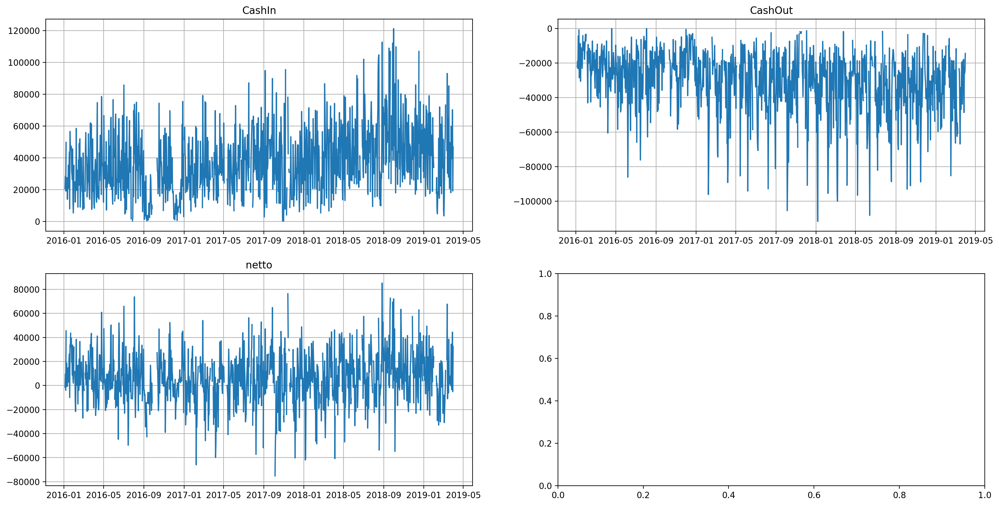

In [40]:
ts.plot();

График кросс-корреляции показывает взаимосвязь между рядами:

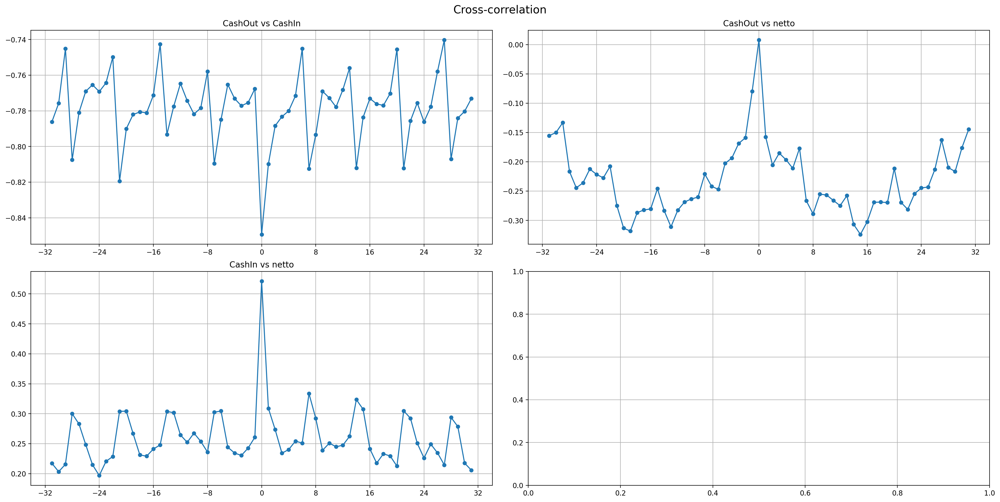

In [41]:
cross_corr_plot(ts, maxlags=31)

Сильнее всего взаимосвязь между `CashIn` и `CashOut`.

### Работа с пропущенными значениями и аутлаерами

Проанализируем, есть ли в данных пропущенные значения, и подберем оптимальный метод их заполнения средствами ETNA. 
Также сохраним заполненные данные в отдельный объект, поскольку некоторые модели заполняют пропуски встроенными методами, и подача на вход «сырых» данных (данные с нерегулярными интервалами) может принести лучший результат.

In [236]:
from etna.transforms import MedianOutliersTransform, TimeSeriesImputerTransform, DensityOutliersTransform

from etna.analysis.outliers import (get_anomalies_density, get_anomalies_hist,
                                    get_anomalies_median, get_anomalies_prediction_interval)

from etna.analysis import (plot_imputation, distribution_plot, plot_anomalies,
                           plot_anomalies_interactive, plot_backtest,
                           plot_correlation_matrix, plot_forecast,
                           sample_acf_plot, sample_pacf_plot, get_residuals, plot_residuals)

In [263]:
raw_ts = deepcopy(ts)                  # это будет TDS без преобразований
ts_no_nans = deepcopy(ts)              # это будет TDS, очищенный от NaN-ов
ts_no_nans_transformed = deepcopy(ts)  # это будет TDS, очищенный от NaN-ов и со сглаженными аутлаерами

In [44]:
ts.info()

<class 'etna.datasets.TSDataset'>
num_segments: 3
num_exogs: 0
num_regressors: 0
num_known_future: 0
freq: D
         start_timestamp end_timestamp  length  num_missing
segments                                                   
CashIn        2016-01-05    2019-03-31    1182          101
CashOut       2016-01-05    2019-03-31    1182           88
netto         2016-01-05    2019-03-31    1182          110


В данных есть пропущенные значения, о чем уже говорилось выше. Посмотрим на них:

In [45]:
original_df[original_df.isna().any(axis=1)].head(15)

,CashIn,CashOut,netto,timestamp
8,NaN,NaN,NaN,2016-01-09
22,NaN,NaN,NaN,2016-01-23
32,NaN,NaN,NaN,2016-02-02
33,NaN,NaN,NaN,2016-02-03
63,NaN,-33930.0,NaN,2016-03-04
64,NaN,-39010.0,NaN,2016-03-05
154,NaN,-24030.0,NaN,2016-06-03
206,NaN,-7120.0,NaN,2016-07-25
208,NaN,-7910.0,NaN,2016-07-27
254,NaN,-12960.0,NaN,2016-09-11


*Замечание*: часто NaN идут подряд, и пропуски есть по всем сегментам.

Кажется, что уместны две стратегии импутации `NaN`-ов: `running_mean` и `seasonal`. Я выбрал `seasonal`, т.к. датасету присуща очень выраженная сезонность. Если использовать `running_mean`, новые значения будут не сильно отличаться от тренда временного ряда, который меняется очень слабо на протяжении времени.

Изначально хотелось брать значение `seasonality`, равное 7 или 14, но в таком случае самые ранние `NaN`-ы не заполнялись, т.к. они встречались в датасете раньше этого значения `seasonality` (первый `NaN` на 5-м месте). Поэтому пришлось пойти на такое ограничение, чтобы избежать ошибок в работе моделей и других методов анализа временных рядов.

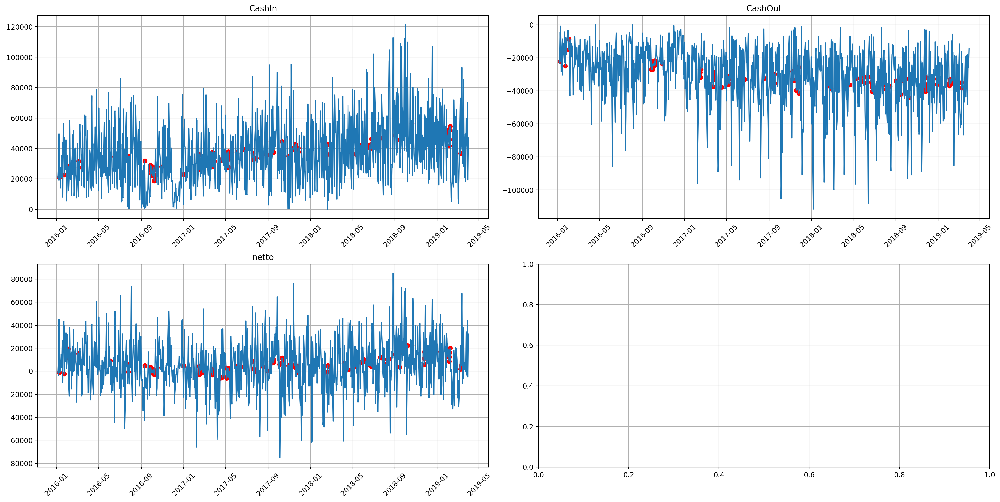

In [264]:
nans_imputer = TimeSeriesImputerTransform(in_column="target", strategy="seasonal", window=14, seasonality=4)
plot_imputation(imputer=nans_imputer, ts=ts, columns_num=2)

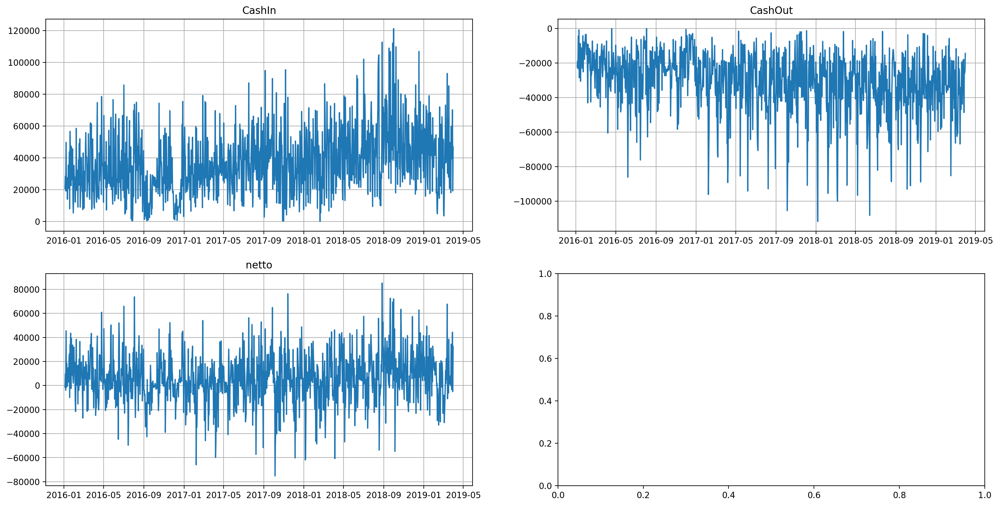

In [265]:
# заполняем NaN-ы
ts_no_nans.fit_transform([nans_imputer])
ts_no_nans_transformed.fit_transform([nans_imputer])

ts_no_nans.plot()

In [50]:
ts_no_nans.info()  # NaN-ов больше нет

<class 'etna.datasets.TSDataset'>
num_segments: 3
num_exogs: 0
num_regressors: 0
num_known_future: 0
freq: D
         start_timestamp end_timestamp  length  num_missing
segments                                                   
CashIn        2016-01-05    2019-03-31    1182            0
CashOut       2016-01-05    2019-03-31    1182            0
netto         2016-01-05    2019-03-31    1182            0


Проверим ряды на наличие аутлаеров, и очистим их соответствующим образом.

*В начале детектируем аутлаеры в рядах:*

In [240]:
segment = "netto"  
method = get_anomalies_density  # также пробовал get_anomalies_median  get_anomalies_density
params_bounds = {"window_size": (5, 150, 1), "distance_coef": (1, 3, 0.5), "n_neighbors": (1, 100, 1)}

In [55]:
# визуализация занимает много места, при необходимости ее можно раскомментировать

# plot_anomalies_interactive(
#     ts=ts, segment=segment, method=method, params_bounds=params_bounds
# )

In [241]:
best_params = {"window_size": 21, "distance_coef": 1.0, "n_neighbors": 2}

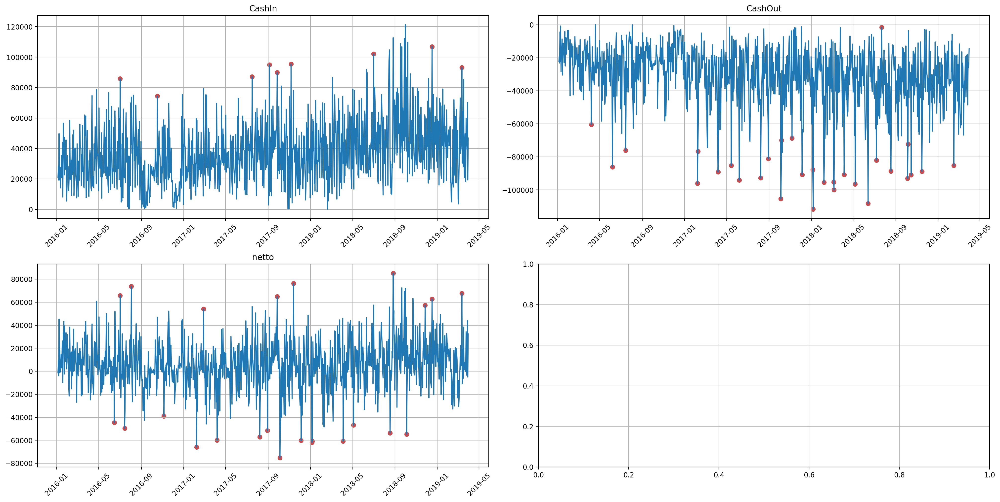

In [242]:
anomaly_dict = get_anomalies_density(ts_no_nans, **best_params)
plot_anomalies(ts_no_nans, anomaly_dict)

*Примечание*: на самом деле, частые «выбросы» довольно симптоматичны, они появляются с определенной периодичностью. Поэтому удаление большого числа выделяющихся наблюдений не является рациональной стратегией. Стоит сглаживать только самые экстремальные наблюдения.

In [58]:
l = ['CashIn', 'CashOut', 'netto']
for i in l:
    print(f'Outliers ({i}): {len(anomaly_dict[i]) / 1182 * 100:.3f}%')

Outliers (CashIn): 0.761%
Outliers (CashOut): 2.538%
Outliers (netto): 2.030%


*Теперь заменим их (сгладим) и посмотрим на новый датасет:*

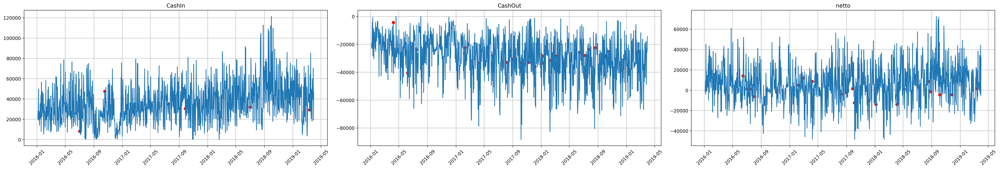

In [243]:
ts_copy = deepcopy(ts_no_nans)

outliers_remover = DensityOutliersTransform(in_column="target", **best_params)
ts_copy.fit_transform([outliers_remover])
outliers_imputer = TimeSeriesImputerTransform(in_column="target", strategy="seasonal", window=14, seasonality=90)

plot_imputation(imputer=outliers_imputer, ts=ts_copy, columns_num=3)

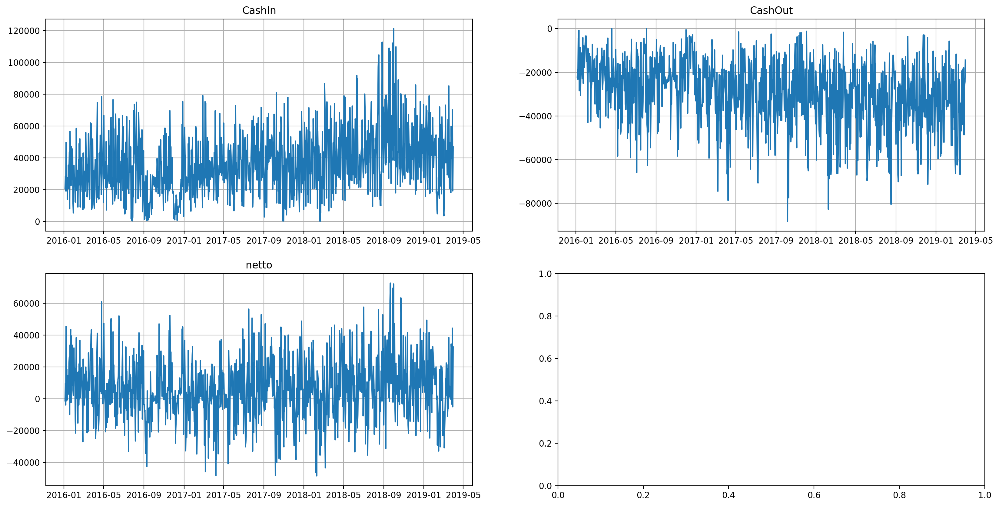

In [244]:
# применим трансформации
# в начале меняем аутлаеры на NaN-ы
outliers_remover = DensityOutliersTransform(in_column="target", **best_params)
# заменяем NaN-ы
outliers_imputer = TimeSeriesImputerTransform(in_column="target", strategy="seasonal", window=14, seasonality=90)

ts_no_nans_transformed.fit_transform([outliers_remover, outliers_imputer])
ts_no_nans_transformed.plot()

In [62]:
ts_no_nans_transformed.info()  # NaN-ов тоже нет

<class 'etna.datasets.TSDataset'>
num_segments: 3
num_exogs: 0
num_regressors: 0
num_known_future: 0
freq: D
         start_timestamp end_timestamp  length  num_missing
segments                                                   
CashIn        2016-01-05    2019-03-31    1182            0
CashOut       2016-01-05    2019-03-31    1182            0
netto         2016-01-05    2019-03-31    1182            0


**Данные очищены от пропущенных значений и аутлаеров.**

### Построение мультисегментной модели

Построим мульти-сегментную модель на основе Prophet, и оцените качество по SMAPE на кросс-валидации. В качестве горизонта предсказания возьмем 5 дней — этого же горизонта будем придерживаться и в дальнейшем.

Отрисуем получившийся прогноз.

In [245]:
from etna.pipeline import Pipeline
from etna.models import ProphetModel
from etna.metrics import SMAPE, MAE
from etna.analysis import plot_backtest

In [65]:
HORIZON = 5

In [246]:
# код ниже для того, чтобы убрать предупреждения во время работы ProphetModel
# источник: https://mc-stan.org/cmdstanpy/users-guide/outputs.html

import logging
cmdstanpy_logger = logging.getLogger("cmdstanpy")
cmdstanpy_logger.disabled = True

In [67]:
model = ProphetModel(daily_seasonality=True)  # daily_seasonality=True выставлено, чтобы избежать предупреждений во время работы модели
transforms = [outliers_remover, outliers_imputer]
pipeline = Pipeline(model=model, transforms=transforms, horizon=HORIZON)

In [68]:
metrics_df, forecast_df, fold_info_df = pipeline.backtest(
    ts=ts_no_nans, metrics=[SMAPE(), MAE()], aggregate_metrics=True
)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    5.5s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:   10.8s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:   16.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:   21.3s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:   26.4s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:   26.4s finished


*Метрики и визуализация:*

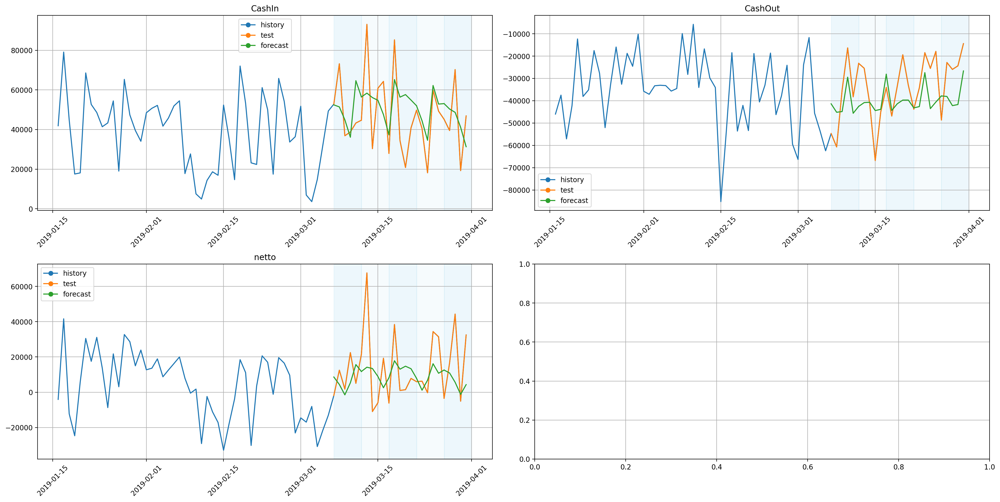

In [69]:
plot_backtest(forecast_df, ts_no_nans, history_len=50)

Модель «поймала» тренд, но не допредсказывает амплитуду данных.

Посмотрим на статистики **SMAPE** по каждому ряду:

In [70]:
metrics_df[['segment', 'SMAPE']]

,segment,SMAPE
0,CashIn,30.960792
1,CashOut,34.628624
2,netto,133.422028


Видно, что модель намного лучше справляется с предсказанием сегментов `CashIn` и `CashOut` по отдельности, чем сразу `netto`. Следовательно, логичнее в начале предсказывать `CashIn` и `CashOut`, а потом считать итоговое значение нетто, которое мы определили как сумму двух других сегментов.

Посмотрим на **MAE**:

In [72]:
metrics_df[['segment', 'MAE']]

,segment,MAE
0,CashIn,14318.624810
1,CashOut,11670.941561
2,netto,15207.236756


Судя по MAE, лучше тоже в начале предсказывать `CashIn` и `CashOut`, но с MAE разница между метриками уже не столь значительна — не на порядок.

Заведем DataFrame с результатами работы разных алгоримтов для сравнения.

In [86]:
# dataframe для сравнения 
df_metrics = pd.DataFrame(columns=['MAE (CV) - CashIn',
                                   'MAE (CV) - CashOut',
                                   'MAE (CV) - netto',
                                   'SMAPE (CV) - CashIn',
                                   'SMAPE (CV) - CashOut',
                                   'SMAPE (CV) - netto'])

# добавление очередной строки с характеристиками метода
df_metrics.loc['ProphetModel (multiseg)'] = [
    14318.624810,
    11670.941561,
    15207.236756,
    30.960792,
    34.628624,
    133.422028
]
df_metrics

,MAE (CV) - CashIn,MAE (CV) - CashOut,MAE (CV) - netto,SMAPE (CV) - CashIn,SMAPE (CV) - CashOut,SMAPE (CV) - netto
ProphetModel (multiseg),14318.62481,11670.941561,15207.236756,30.960792,34.628624,133.422028


### Иерархический временной ряд

Вывод выше подводит нас к концепции **иерархического временного ряда** (когда один ряд состоит из других в качестве компонент). Это полезная концепция, которая может встретиться во многих задачах.

На выходе мы получим `TSDataset` с иерархической структурой, а также соответствующий реконсилятор, который позволит собирать искомый ряд из составных компонент.

In [73]:
from etna.datasets import HierarchicalStructure
from etna.pipeline import HierarchicalPipeline
from etna.reconciliation import BottomUpReconciliator

In [74]:
# еще раз подготовлю исходный датасет к трансформации
df_CashIn_CashOut = pd.melt(original_df, id_vars=['timestamp'], value_vars=['CashIn', 'CashOut'], var_name='segment', value_name='target', ignore_index=True)

hierarchical_df = TSDataset.to_dataset(df=df_CashIn_CashOut)
hierarchical_df.head()

segment,CashIn,CashOut
feature,target,target
timestamp,,
2016-01-05,20840.0,-22200.0
2016-01-06,28460.0,-18810.0
2016-01-07,19250.0,-23210.0
2016-01-08,49770.0,-4350.0
2016-01-09,NaN,NaN


In [75]:
# определим иерархическую двухуровневую структуру
hierarchical_structure = HierarchicalStructure(
    level_structure={"netto": ["CashIn", "CashOut"]}, level_names=["total", "reason"]
)

hierarchical_structure

HierarchicalStructure(level_structure = {'netto': ['CashIn', 'CashOut']}, level_names = ['total', 'reason'], )

In [76]:
# определим TSDataset с иерархической структурой 
hierarchical_ts = TSDataset(df=hierarchical_df, freq="D", hierarchical_structure=hierarchical_structure)

hierarchical_ts.head()

segment,CashIn,CashOut
feature,target,target
timestamp,,
2016-01-05,20840.0,-22200.0
2016-01-06,28460.0,-18810.0
2016-01-07,19250.0,-23210.0
2016-01-08,49770.0,-4350.0
2016-01-09,NaN,NaN


Далее применим такие же трансформации по замене `NaN`-ов и сглаживанию аутлаеров.

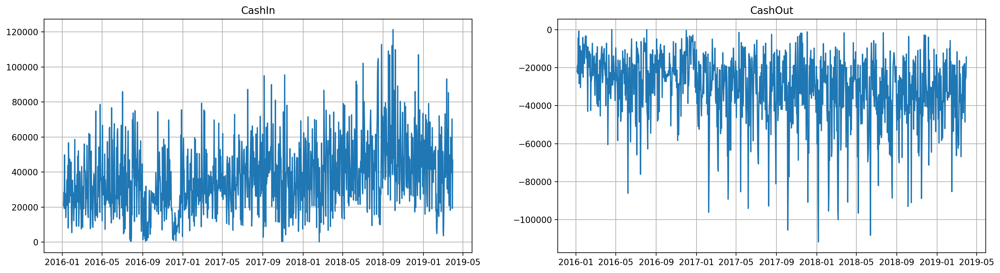

In [77]:
# такие же параметры
nans_imputer = TimeSeriesImputerTransform(in_column="target", strategy="seasonal", window=14, seasonality=4)

# копии датасетов по таком же принципу, что и выше
hierarchical_ts_raw = deepcopy(hierarchical_ts)
hierarchical_ts_no_nans = deepcopy(hierarchical_ts)
hierarchical_ts_no_nans_transformed = deepcopy(hierarchical_ts)

hierarchical_ts_no_nans.fit_transform([nans_imputer])
hierarchical_ts_no_nans_transformed.fit_transform([nans_imputer])
hierarchical_ts_no_nans.plot()

In [78]:
# проверим уровни датасета и текущий уровень
hierarchical_ts_no_nans.hierarchical_structure.level_names, hierarchical_ts_no_nans.current_df_level

(['total', 'reason'], 'reason')

In [79]:
# так выглядит верхний уровень (нетто)
hierarchical_ts_no_nans.get_level_dataset(target_level="total").head()

segment,netto
feature,target
timestamp,
2016-01-05,-1360.0
2016-01-06,9650.0
2016-01-07,-3960.0
2016-01-08,45420.0
2016-01-09,-1360.0


In [80]:
# определим реконсилятор
reconciliator = BottomUpReconciliator(target_level="total", source_level="reason")
reconciliator.fit(ts=hierarchical_ts_no_nans)

BottomUpReconciliator(target_level = 'total', source_level = 'reason', )

Далее применим найденные на предыдущих этапах преобразования очистку от аутлаеров уже к иерархическому датасету и запустим на нем Prophet с MAE на кросс-валидации.

In [81]:
# те же самые трансформы для аутлаеров
# импутация NaN-ов уже применена
outliers_remover = DensityOutliersTransform(in_column="target", **best_params)
outliers_imputer = TimeSeriesImputerTransform(in_column="target", strategy="seasonal", window=14, seasonality=90)

In [82]:
model = ProphetModel(daily_seasonality=True)
transforms = [outliers_remover, outliers_imputer]
pipeline = HierarchicalPipeline(
    model=model,
    transforms=transforms,
    horizon=HORIZON,
    reconciliator=reconciliator,
)

In [83]:
bottom_up_metrics, bottom_up_forecast_df, bottom_up_fold_info_df = pipeline.backtest(
    ts=hierarchical_ts_no_nans, metrics=[SMAPE(), MAE()], aggregate_metrics=True
)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    4.4s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    8.7s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:   12.6s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:   17.8s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:   21.5s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:   21.5s finished


In [89]:
bottom_up_metrics

,segment,SMAPE,MAE
0,netto,128.952013,15206.247936


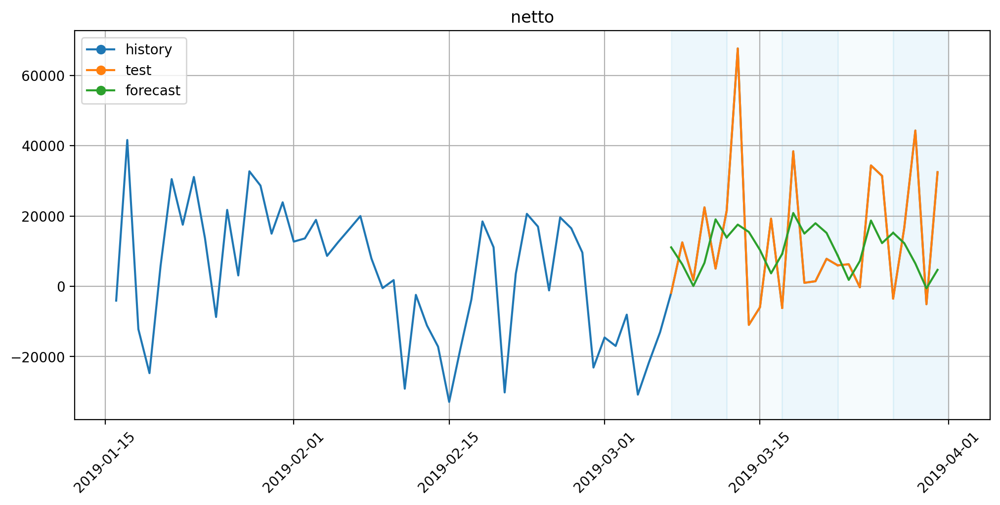

In [88]:
plot_backtest(bottom_up_forecast_df, hierarchical_ts_no_nans.get_level_dataset(target_level="total"), history_len=50)

In [90]:
# добавление очередной строки с характеристиками метода
df_metrics.loc['ProphetModel (hierarhical)'] = [
    None,
    None,
    15206.247936,
    None,
    None,
    128.952013
]
df_metrics

,MAE (CV) - CashIn,MAE (CV) - CashOut,MAE (CV) - netto,SMAPE (CV) - CashIn,SMAPE (CV) - CashOut,SMAPE (CV) - netto
ProphetModel (multiseg),14318.62481,11670.941561,15207.236756,30.960792,34.628624,133.422028
ProphetModel (hierarhical),NaN,NaN,15206.247936,NaN,NaN,128.952013


**Итог**: *метрики почти не изменились*: МАЕ стала лучше совсем немного, а SMAPE — улучшилась на 5 п.п. Визуально предсказания не изменились.

Возможно, модель `Prophet` плохо подходит к нашим данным.

### Построение признаков

Вернемся к нашему исходному мультисегментному ряду — теперь поработаем с моделями, которые требуют построения признаков — `ARIMA` и `CatBoost`. 
Построим для них признаки, и попробуем при помощи них добиться улучшения качества. 

Кроме того:
* построим графики автокорреляции и при помощи них обоснуем выбор лаговых признаков,
* для катбуста включим в признаки результаты STL разложения. 

Также в конце подумаем на экспертном уровне, какие закономерности могут присутствовать в пополнени и снятии наличности из банкомата.
После этого обучим на получившихся признаках модели.

In [91]:
from etna.analysis import sample_acf_plot, sample_pacf_plot, stl_plot
from etna.ensembles import DirectEnsemble, StackingEnsemble, VotingEnsemble
from etna.models import (CatBoostMultiSegmentModel, CatBoostModelPerSegment,
                         AutoARIMAModel)
from etna.transforms import (STLTransform, LagTransform, SegmentEncoderTransform, 
                             HolidayTransform, TrendTransform, LogTransform, LinearTrendTransform,
                             DateFlagsTransform, MeanTransform, FilterFeaturesTransform)

*Поскольку временной ряд очень большой, посмотрим на функции автокорреляции в нескольких перспективах: в течение года, нескольких месяцев и одного месяца.*

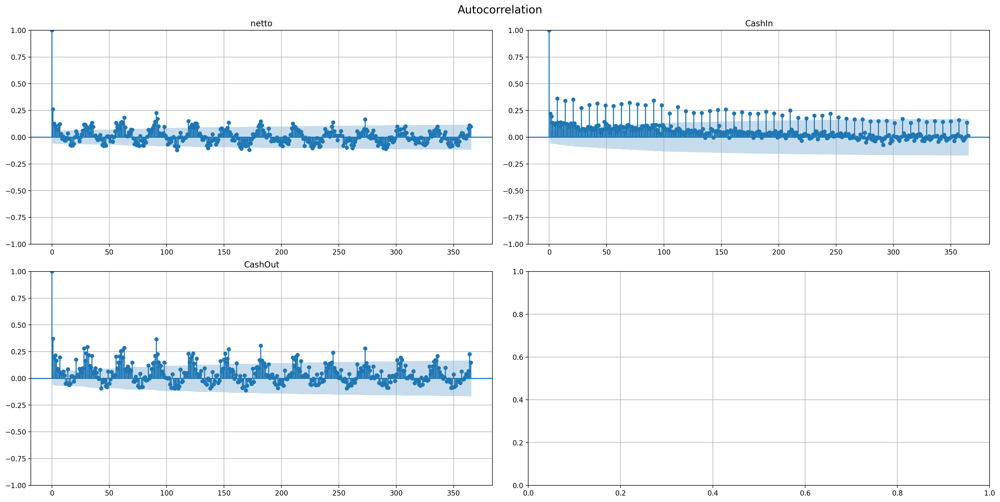

In [92]:
sample_acf_plot(ts_no_nans, lags=365)

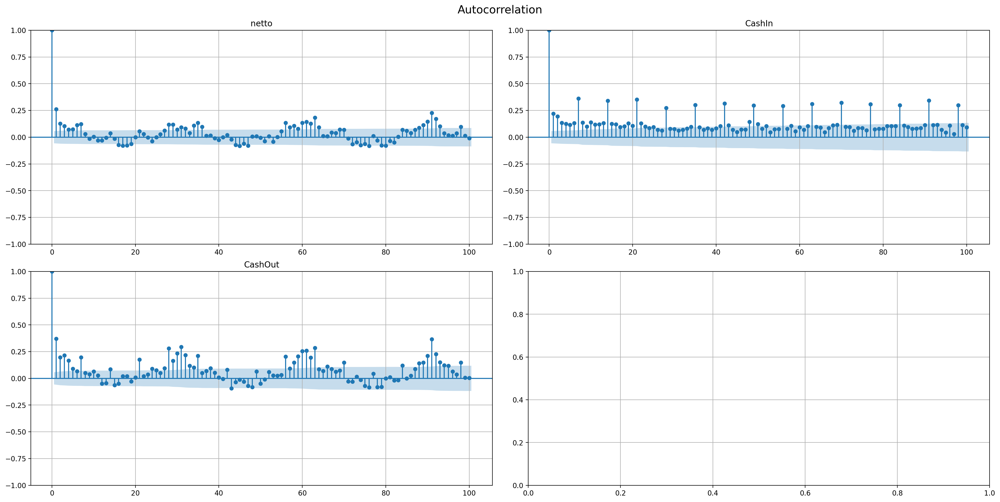

In [93]:
sample_acf_plot(ts_no_nans, lags=100)

Если смотреть на **автокорреляцию**, можно выделить следующие значимые лаги:
* `CashIn`: все первые 21 дни (слабо), затем каждые 7 дней — можно предположить, что сумма положенных денег в короткой перспективе положительно связана с днями. Далее включается типичная недельная сезонность, свойственная потребительским финансам
* `CashOut`: первые 7 дней (слабо), затем 21-й день и каждые 30 дней +- 3 дня (сильно) — более крупная сезонность, которая может быть связана с получением зарплат, выплат и т.д.
* `netto`: аналогично `CashOut`

Теперь посмотрим на *частную автокорреляцию*:

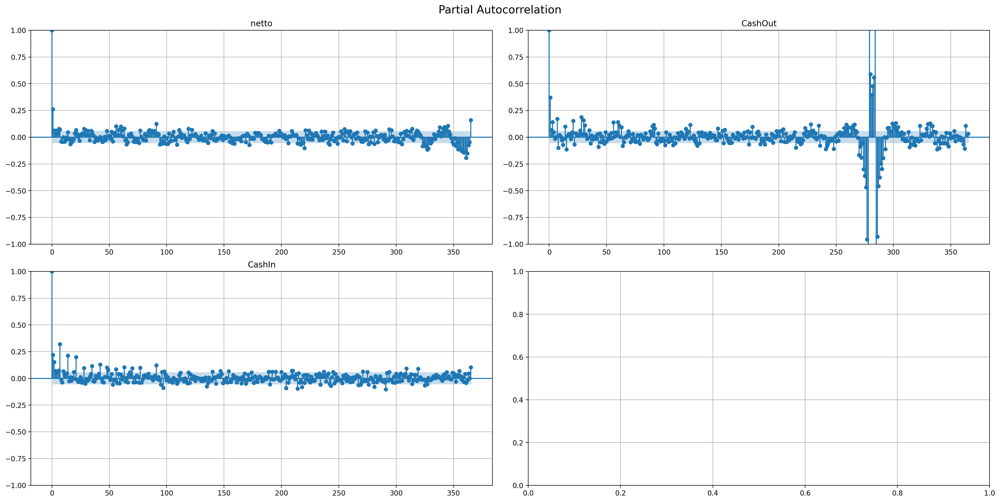

In [94]:
sample_pacf_plot(ts_no_nans, lags=365)

Сильные взрывы связаны с аутлаерами, если применить их сглаживание, они пропадут на графике функции.

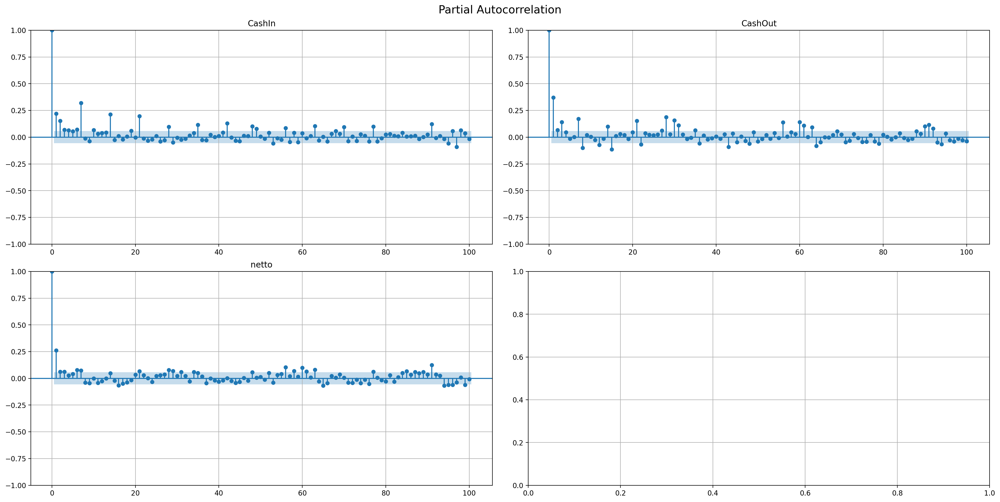

In [95]:
sample_pacf_plot(ts_no_nans, lags=100)

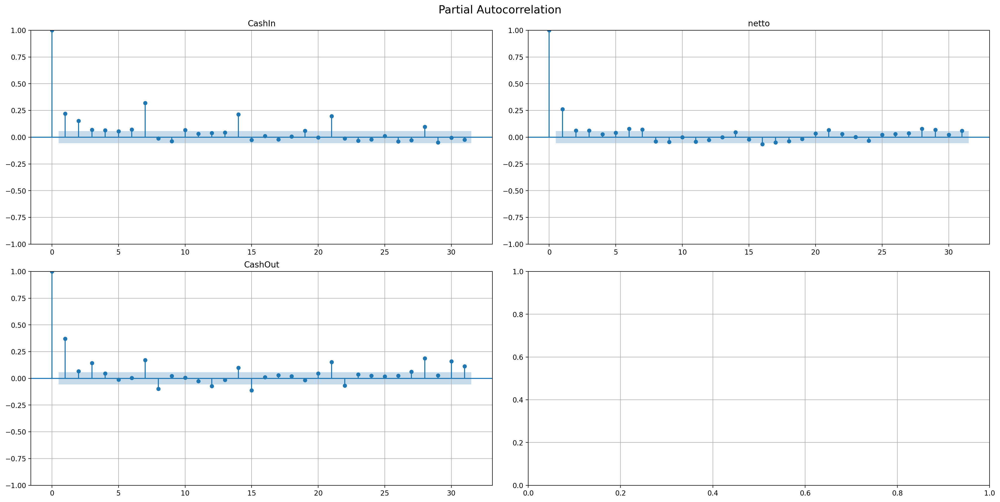

In [96]:
sample_pacf_plot(ts_no_nans, lags=31)

Судя по **частной автокорреляции**, можно выделить:
* `CashIn`: 1, 2, 7, далее каждые 7 дней — в ближайшей перспективе 1-2 дня связь логичная: можно вносить большие суммы денег за несколько дней подряд, сезонность в 7 дней свойственна таким данным
* `CashOut`: 1, 3, далее каждые 7 и 7 + 1 дни — про первые дни говорилось выше, далее: недельная сезонность и закономерный спад на следующий день, значение частной автокор. меняет знак — вероятно, если в условный понедельник сняли много денег, на следующий день снимут намного меньше денег
* `netto`: практически нет значимых значений, можно выделить 1 день и каждые 7 (недолго)

Теперь посмотрим на **STL-разложение**:

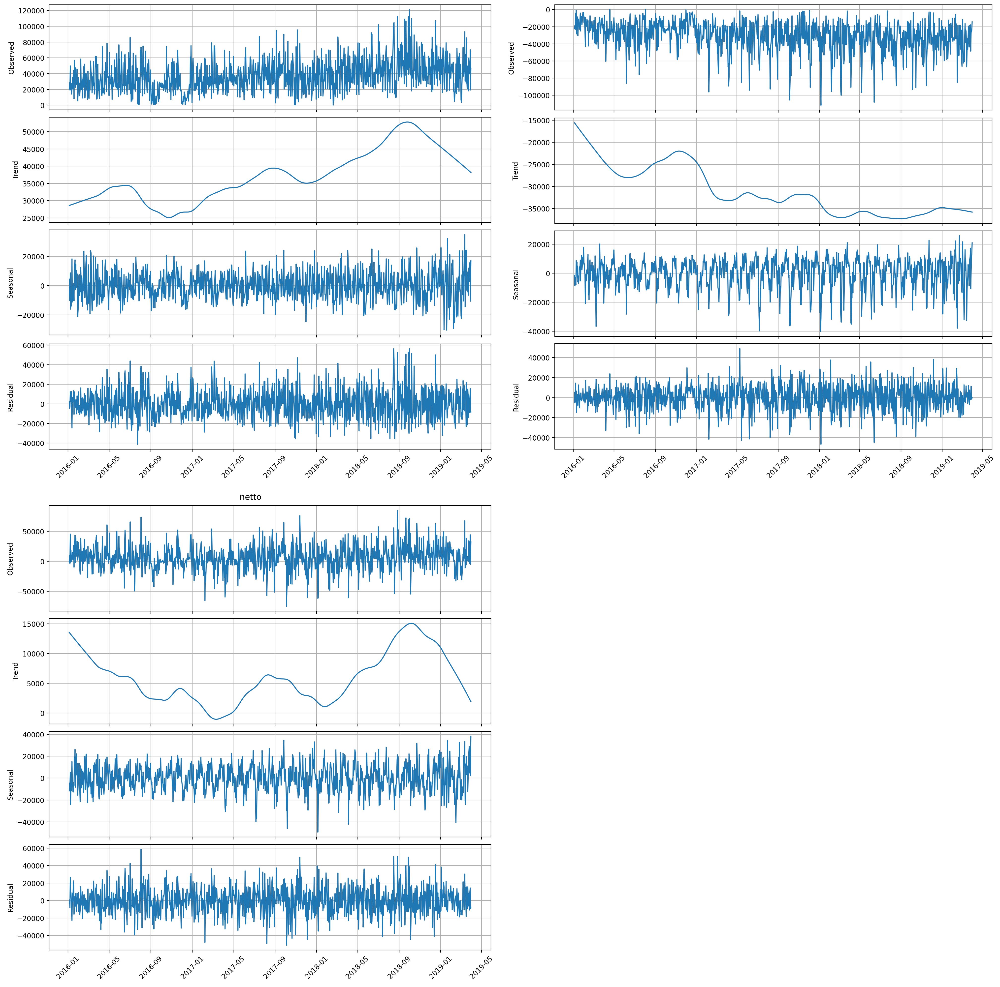

In [97]:
stl_plot(ts=ts_no_nans, period=90)

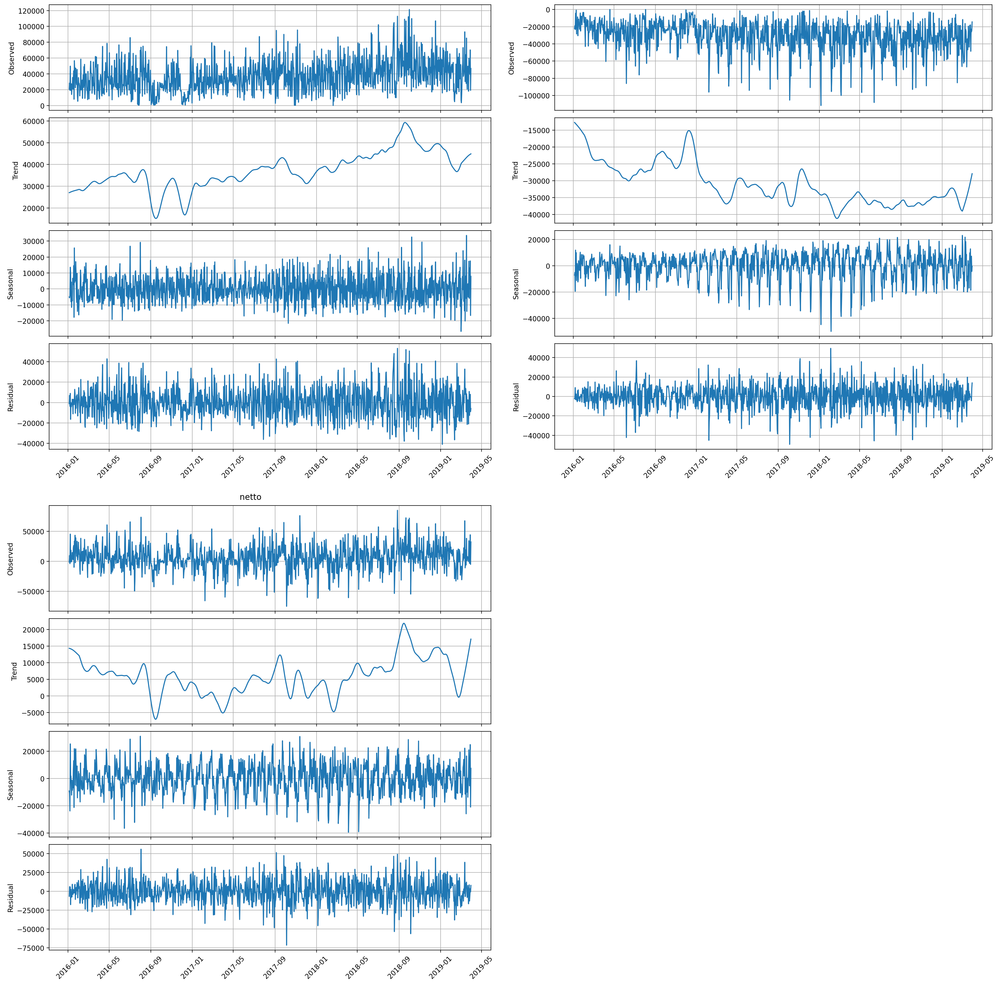

In [98]:
stl_plot(ts=ts_no_nans, period=30)

Хотя **STL** с периодом 90 и выглядит более сглаженным, попробуем вариант с периодом 30, т.к. с ним остатки получаются меньше.

Говоря о возможных **признаках**, отслеживающих закономерности в пополнени и снятии наличных из банкомата, нужно задуматься о таких периодичных вещах, как:
* **выплата зарплаты** — относится и к пополнению, и к снятию. Но, вероятно, это сложно отследить, поскольку эти выплаты приходят, хоть и циклично, но в разное время. Возможно, есть единые дни выплат сотрудникам гос. органов или больших корпораций, но для этого желательно дополнительно учесть расположение банкомата — такой информации нет
* **еженедельные пополнения и снятия** — думаю, что людям свойственно еженедельно класть или снимать наличные перед началом новой недели или в конце старой. Для этого я обязательно учту лаг 7 и далее с шагов в 7, он выглядит значимым на протяжении долгого времени
* **ежемесячные пополнения и снятия** — с большей периодичностью могут вноситься крупные суммы денег на кредитную карту. Однако здесь важно учесть как лаг 30, так и несколько шагов в обе стороны от него, чтобы компенсировать месяцы, в которых четное и нечетное число дней. Этот лаг может частично впитать в себя информацию про зарплатные операции
* **политические и экономические факторы** — очевидно, большинство аутлаеров были так или иначе связаны с событиями из реального мира. В ситуациях нестабильности людям свойственно снимать большие суммы денег. В случае социальных выплат или повышения процентов по вкладам — наоборот. К сожалению, такие факторы нельзя учесть и под них опасно переобучиться. В теории, можно было бы учесть такие факторы, к примеру, данными об инфляции, но для этого нужно отдельно собирать их
* **тренд** — вероятно, перед сезонами отпусков многие люди, собираясь в поездку или просто получив отпускные, захотят положить деньги на банковскую карту. Это можно учесть через добавление таких признаков, как номер недели в году или номер месяца

#### Модель ARIMA

ARIMA очень плохо работает на кросс-валидации (вызывает ошибки из-за лагов), поэтому в этом разделе применим ее для обычной тестовой выборки, соответствующей заданному горизонту предсказания.

In [99]:
# тестовая выборка соответствует горизонту предсказания

train_ts_ar, test_ts_ar = ts_no_nans.train_test_split(
    train_start="2016-01-05",
    train_end="2019-03-26",
    test_start="2019-03-27",
    test_end="2019-03-31",
)

In [100]:
# лаги, которые были выявлены через авторегрессионную функцию и экспертным путем
# брать лаги менее 7 кажется нецелесообразным, т.к. иначе модель будет сильно зависеть от своих же ближайших предсказаний и накапливать ошибку
l1 = list(range(7, 30, 7))
l2 = list(range(8, 30, 7))
l3 = list(range(30, 365, 30))
l4 = list(range(31, 365, 30))
l5 = list(range(28, 100, 30))
l6 = list(range(32, 100, 30))
l7 = list(range(29, 365, 30))

# по какой-то причине модель ARIMA не принимает следующие лаги и выдает на них ошибку
# принято решение исключить их из множества лагов
no = {21, 22, 58, 88, 89, 90, 91, 92, 119, 121, 209, 210, 239, 240, 241, 299, 300, 301}

days = set(l1 + l2 + l3 + l4 + l5 + l6 + l7)
days_arima = sorted(days - no)
# catboost принимает все лаги
days_ctbst = sorted(days)

In [102]:
# трансформации для модели ARIMA
trend = LinearTrendTransform(in_column="target")
seg = SegmentEncoderTransform()
lags = LagTransform(in_column="target", lags=days_arima)
d_flags = DateFlagsTransform(
    day_number_in_week=True,
    day_number_in_month=True,
    week_number_in_month=True,
    week_number_in_year=True,
    month_number_in_year=True,
    year_number=True,
    is_weekend=True,
    special_days_in_week=[5, 6],
)

holid = HolidayTransform(iso_code="TR", out_column="TR_holidays")  # турецкие выходные

In [103]:
# для отладки модели использовался сокращенный набор лагов
# он показывает практически такое же качество, но работает быстрее
# lags = LagTransform(in_column="target", lags=[7, 8, 14, 15, 28, 29, 30, 31, 32, 59, 60, 61, 62])

# применяем трансформации к датасету
train_ts_ar.fit_transform([outliers_remover, outliers_imputer, lags, trend, seg, d_flags, holid])

model_arima = AutoARIMAModel()
# обучение модели
model_arima.fit(train_ts_ar)
# предсказание
future_ts_arima = train_ts_ar.make_future(HORIZON)
forecast_ts_arima = model_arima.forecast(future_ts_arima)

In [105]:
smape = SMAPE()
mae = MAE()

smape_res_ar = smape(y_true=test_ts_ar, y_pred=forecast_ts_arima)
mae_res_ar = mae(y_true=test_ts_ar, y_pred=forecast_ts_arima)

print(f"SMAPE = {smape_res_ar['netto']:.2f}")
print(f"MAE   = {mae_res_ar['netto']:.2f}")

SMAPE = 128.59
MAE   = 19717.43


Визуализация:

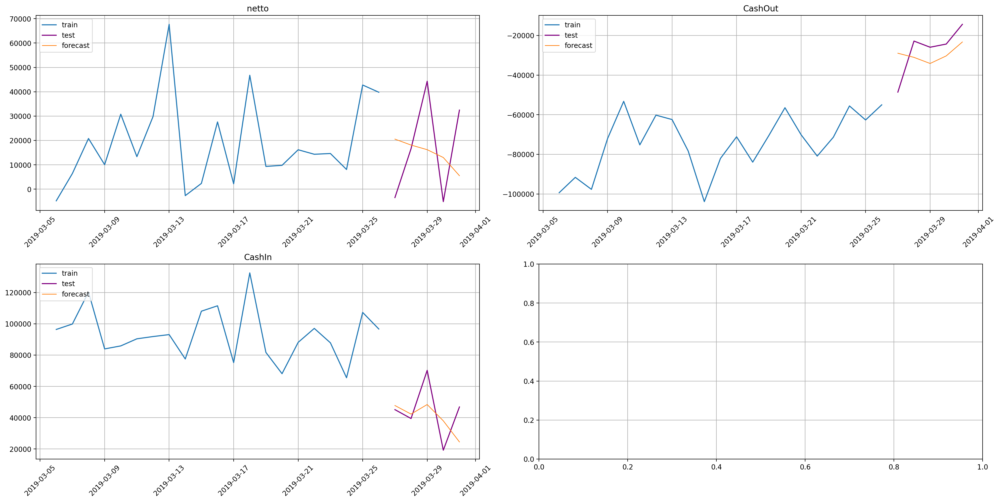

In [107]:
train_ts_ar.inverse_transform()
plot_forecast(forecast_ts_arima, test_ts_ar, train_ts_ar, n_train_samples=21)

In [110]:
mae_res_ar, smape_res_ar

({'netto': 19717.430669665122,
  'CashOut': 10184.759754477749,
  'CashIn': 13680.519354411623},
 {'netto': 128.5883309596188,
  'CashOut': 35.49485924832926,
  'CashIn': 35.5001319439686})

In [111]:
# добавление очередной строки с характеристиками метода
df_metrics.loc['ARIMA (not CV)'] = [
    13680.519354411623,
    10184.759754477749,
    19717.430669665122,
    35.5001319439686,
    35.49485924832926,
    128.5883309596188
]

*Получилось не очень качественно.*

Но во время работы было сделалано интересное открытие — если сократить обучающую выборку, оставив наблюдения с 1 января 2019 г., **модель ARIMA будет очень хорошо предсказывать временной ряд:**

In [113]:
# сокращенный train
train_ts_ar, test_ts_ar = ts_no_nans.train_test_split(
    train_start="2019-01-05",
    train_end="2019-03-26",
    test_start="2019-03-27",
    test_end="2019-03-31",
)

# небольшие лаги
lags = LagTransform(in_column="target", lags=[7, 8, 14, 15, 28, 29, 30, 31, 32, 59, 60, 61, 62])
train_ts_ar.fit_transform([lags, holid])

# обучаем модель и предсказываем тест
model_arima = AutoARIMAModel()
model_arima.fit(train_ts_ar)
future_ts_arima = train_ts_ar.make_future(HORIZON)
forecast_ts_arima_small = model_arima.forecast(future_ts_arima)

In [115]:
smape = SMAPE()
mae = MAE()

smape_res_small = smape(y_true=test_ts_ar, y_pred=forecast_ts_arima_small)
mae_res_small = mae(y_true=test_ts_ar, y_pred=forecast_ts_arima_small)

print(f"SMAPE = {smape_res_small['netto']:.2f}")
print(f"MAE   = {mae_res_small['netto']:.2f}")

SMAPE = 43.06
MAE   = 7176.10


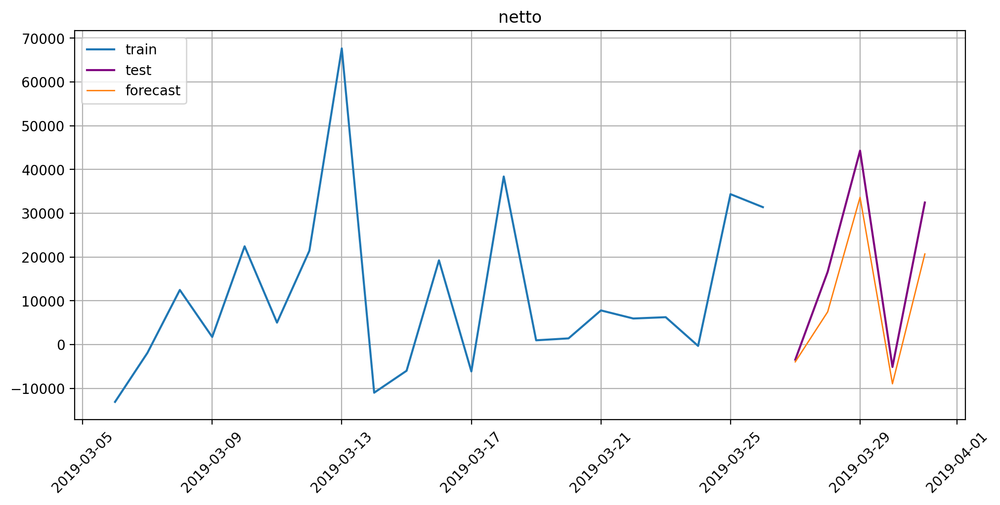

In [120]:
train_ts_ar.inverse_transform()
plot_forecast(forecast_ts_arima_small, test_ts_ar, train_ts_ar, n_train_samples=21, segments=['netto'])

In [118]:
smape_res_small, mae_res_small

({'netto': 43.064345749358,
  'CashOut': 159.86829538300935,
  'CashIn': 47.08164174810516},
 {'netto': 7176.096491667189,
  'CashOut': 29857.549520637043,
  'CashIn': 17953.267775814318})

In [122]:
# добавление очередной строки с характеристиками метода
df_metrics.loc['ARIMA (small & not CV)'] = [
    17953.267775814318,
    29857.549520637043,
    7176.096491667189,
    47.08164174810516,
    159.86829538300935,
    43.064345749358
]

Видим почти идеальное предсказание целевого сегмента, но на `CashOut` ошибаемся сильно.

#### Модель CatBoost

In [124]:
# тестовая выборка соответствует горизонту предсказания

train_ts_cb, test_ts_cb = ts_no_nans.train_test_split(
    train_start="2016-01-05",
    train_end="2019-03-26",
    test_start="2019-03-27",
    test_end="2019-03-31",
)

In [125]:
# признаки для catboost
lags = LagTransform(in_column="target", lags=days_ctbst)
mean14 = MeanTransform(in_column="target", window=14)
holid = HolidayTransform(iso_code="TR", out_column="TR_holidays")
stl = STLTransform(in_column="target", period=30, model="arima")

In [126]:
train_ts_cb.fit_transform([stl, lags, mean14])

# модель CatBoostModelPerSegment работает хуже
# model_catboost = CatBoostModelPerSegment()

# обучаем
model_catboost = CatBoostMultiSegmentModel()
model_catboost.fit(train_ts_cb)
# предсказываем
future_ts_cb = train_ts_cb.make_future(HORIZON)
forecast_ts_cb = model_catboost.forecast(future_ts_cb)

In [127]:
smape = SMAPE()
mae = MAE()

smape_res_cb = smape(y_true=test_ts_cb, y_pred=forecast_ts_cb)
mae_res_cb = mae(y_true=test_ts_cb, y_pred=forecast_ts_cb)

print(f"SMAPE = {smape_res_cb['netto']:.2f}")
print(f"MAE   = {mae_res_cb['netto']:.2f}")

SMAPE = 62.63
MAE   = 10978.26


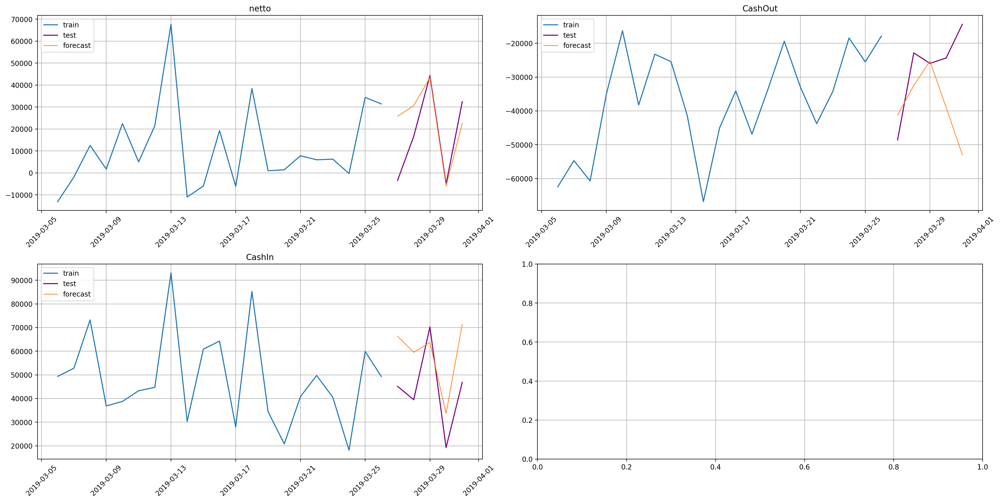

In [128]:
train_ts_cb.inverse_transform()
plot_forecast(forecast_ts_cb, test_ts_cb, train_ts_cb, n_train_samples=21)

In [129]:
mae_res_cb, smape_res_cb

({'netto': 10978.26158402033,
  'CashOut': 14157.010208734151,
  'CashIn': 17338.75615565856},
 {'netto': 62.63043786891031,
  'CashOut': 42.88047641264594,
  'CashIn': 36.83172252974591})

In [132]:
# добавление очередной строки с характеристиками метода
df_metrics.loc['CatBoostMultiSegmentModel (not CV)'] = [
    17338.75615565856,
    14157.010208734151,
    10978.26158402033,
    36.83172252974591,
    42.88047641264594,
    62.63043786891031
]
df_metrics

,MAE (CV) - CashIn,MAE (CV) - CashOut,MAE (CV) - netto,SMAPE (CV) - CashIn,SMAPE (CV) - CashOut,SMAPE (CV) - netto
ProphetModel (multiseg),14318.624810,11670.941561,15207.236756,30.960792,34.628624,133.422028
ProphetModel (hierarhical),NaN,NaN,15206.247936,NaN,NaN,128.952013
ARIMA (not CV),13680.519354,10184.759754,19717.430670,35.500132,35.494859,128.588331
ARIMA (small & not CV),17953.267776,29857.549521,7176.096492,47.081642,159.868295,43.064346
CatBoostMultiSegmentModel (not CV),17338.756156,14157.010209,10978.261584,36.831723,42.880476,62.630438


*Если не считать обучение `ARIMA` на сокращенном датасете, модель `CatBoost` показала себя лучше на целевом ряде.*

### Стратегии прогнозирования

При построении прогноза на горизонте дальше следующего наблюдения перед нами встает задача определиться со стратегией генерации прогноза. Попробуем разные стратегии на нашем горизонте из 5 дней (прямая, рекурсивная, смешанная: dirrec).

In [134]:
from etna.pipeline import AutoRegressivePipeline, Pipeline, assemble_pipelines
from etna.ensembles import DirectEnsemble

#### Прямая стратегия

**CatBoost:**

In [150]:
# используем уже найденные ранее преобразования
model_catboost = CatBoostMultiSegmentModel()

# CatBoostModelPerSegment работает хуже
# model_catboost = CatBoostModelPerSegment()

transforms_catboost = [
    STLTransform(in_column="target", period=30, model="arima"),
    LagTransform(in_column="target", lags=days_ctbst, out_column="target_lag"),
    MeanTransform(in_column="target", window=14),
    HolidayTransform(iso_code="TR", out_column="TR_holidays")
]

pipeline = Pipeline(model=model_catboost, transforms=transforms_catboost, horizon=HORIZON)

In [151]:
metrics_pipeline_df_cb, forecast_pipeline_df_cb, _ = pipeline.backtest(
    ts=ts_no_nans, metrics=[SMAPE(), MAE()], aggregate_metrics=True
)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    8.5s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:   16.3s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:   24.8s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:   33.6s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:   41.3s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:   41.3s finished


In [810]:
metrics_pipeline_df_cb

,segment,SMAPE,MAE
0,CashIn,54.699895,23707.099681
1,CashOut,47.160823,18392.215722
2,target,132.982272,19310.674689


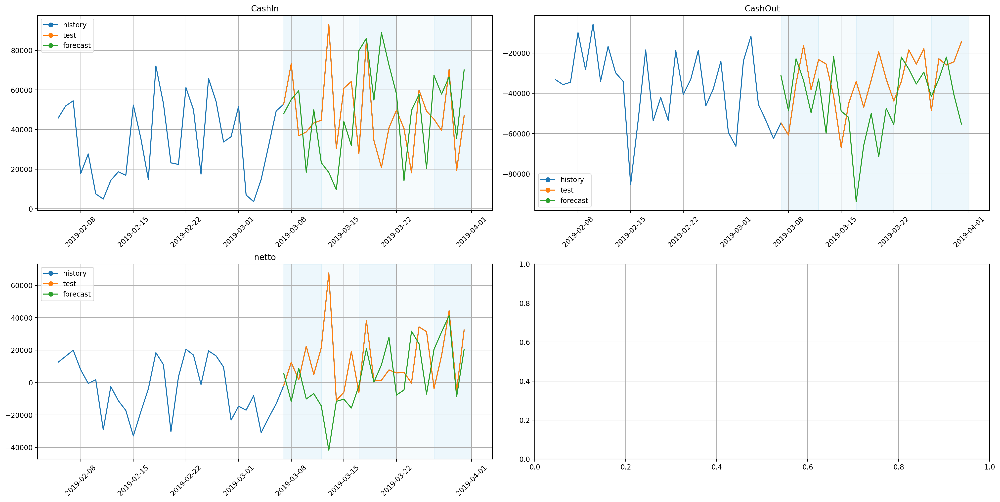

In [154]:
plot_backtest(forecast_pipeline_df_cb, ts_no_nans, history_len=30)

In [157]:
# добавление очередной строки с характеристиками метода
df_metrics.loc['CatBoostMultiSegmentModel'] = [
    23707.099681,
    18392.215722,
    19310.674689,
    54.699895,
    47.160823,
    132.982272
]

**Модель ARIMA**

In [158]:
# ARIMA выдает ошибку при работе с этими лагами, поэтому их пришлось удалить
days_arima_pipeline = sorted(set(days_arima) - {14, 15, 30, 28, 31, 271, 32, 29, 151, 149, 150, 270, 269, 7, 180, 329, 181, 179, 211, 8, 330, 331, 120})

In [159]:
model_arima = AutoARIMAModel()

# трансформации те же
transforms_arima = [
    DensityOutliersTransform(in_column="target", **best_params),
    TimeSeriesImputerTransform(in_column="target", strategy="seasonal", window=14, seasonality=90),
    LagTransform(in_column="target", lags=days_arima_pipeline, out_column="target_lag"),
    LinearTrendTransform(in_column="target"),
    SegmentEncoderTransform(),
    DateFlagsTransform(
        day_number_in_week=True,
        day_number_in_month=True,
        week_number_in_month=True,
        week_number_in_year=True,
        month_number_in_year=True,
        year_number=True,
        is_weekend=True,
        special_days_in_week=[5, 6]
    ),
    HolidayTransform(iso_code="TR", out_column="TR_holidays")
]

pipeline_arima = Pipeline(
    model=model_arima, transforms=transforms_arima, horizon=HORIZON
)

In [160]:
metrics_pipeline_df_ar, forecast_pipeline_df_ar, _ = pipeline_arima.backtest(
    ts=ts_no_nans, metrics=[SMAPE(), MAE()], aggregate_metrics=True,
)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   34.4s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:   58.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:  1.4min remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:  1.6min remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:  1.9min remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:  1.9min finished


In [161]:
metrics_pipeline_df_ar

,segment,SMAPE,MAE
0,CashIn,32.485425,14630.901397
1,CashOut,28.653964,9653.281032
2,netto,122.195501,14534.611797


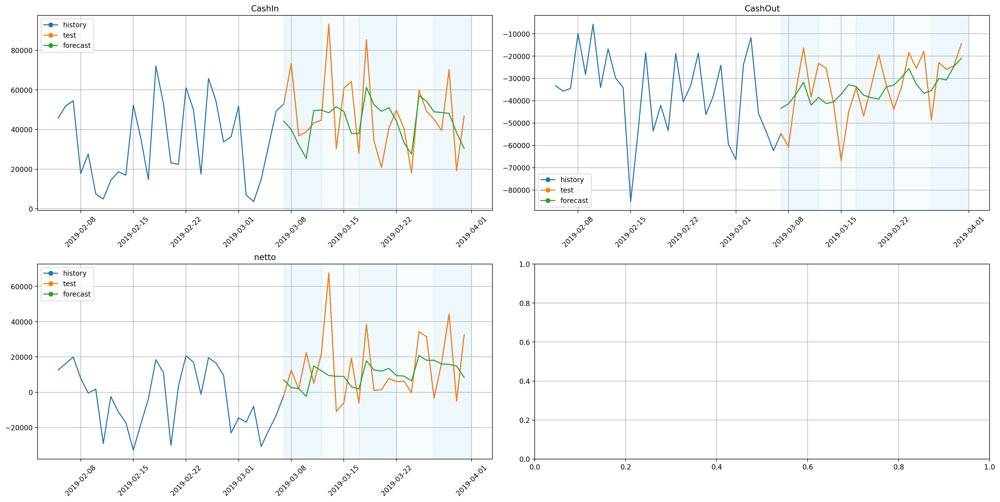

In [162]:
plot_backtest(forecast_pipeline_df_ar, ts_no_nans, history_len=30)

In [165]:
# добавление очередной строки с характеристиками метода
df_metrics.loc['ARIMA'] = [
    14630.901397,
    9653.281032,
    14534.611797,
    32.485425,
    28.653964,
    122.195501
]

**Prophet Model**

In [166]:
# те же самые трансформы для аутлаеров
outliers_remover = DensityOutliersTransform(in_column="target", **best_params)
outliers_imputer = TimeSeriesImputerTransform(in_column="target", strategy="seasonal", window=14, seasonality=90)

In [167]:
model_prophet = ProphetModel(daily_seasonality=True)

transforms_prophet = [outliers_remover, outliers_imputer]

pipeline_prophet = Pipeline(model=model_prophet, transforms=transforms_prophet, horizon=HORIZON)

In [168]:
metrics_pipeline_df_prophet, forecast_pipeline_df_prophet, _ = pipeline_prophet.backtest(
    ts=ts_no_nans, metrics=[SMAPE(), MAE()], aggregate_metrics=True
)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    5.3s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:   11.9s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:   19.5s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:   25.2s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:   34.8s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:   34.8s finished


In [169]:
metrics_pipeline_df_prophet

,segment,SMAPE,MAE
0,CashIn,30.960792,14318.624810
1,CashOut,34.628624,11670.941561
2,netto,133.422028,15207.236756


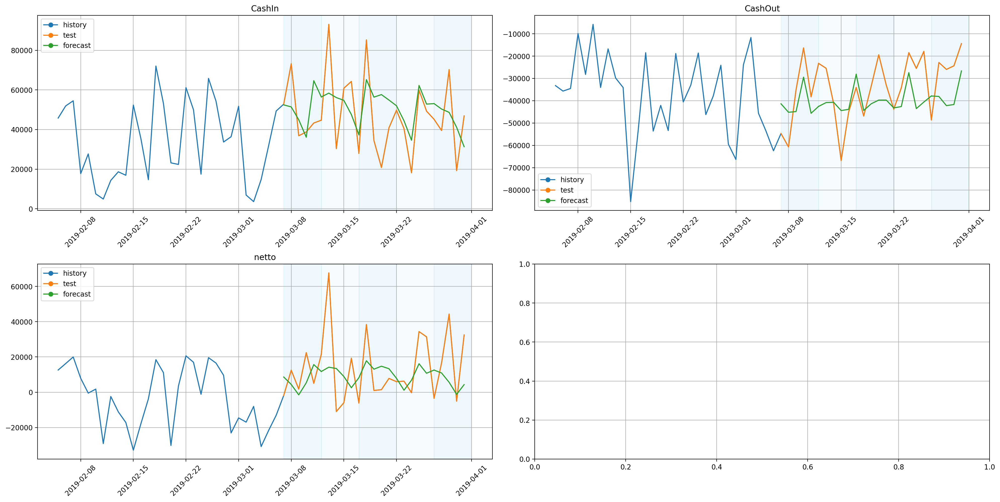

In [173]:
plot_backtest(forecast_pipeline_df_prophet, ts_no_nans, history_len=30)

Результаты `ProphetModel` с прямой стратегией уже заносились в `df_metrics`.

#### Смешанная стратегия (Dirrec)

Возьмем для смешанного подхода **Dirrec** две модели `CatBoost`.

Однако, по задумке стратегии Dirrec, придется изменить горизонты прогнозирования. Кажется логичным брать горизонты 7 и 30: поменьше и побольше с учетом сезонности. 

In [175]:
horizons = [7, 30]

# модели
models = [CatBoostMultiSegmentModel(), CatBoostModelPerSegment()]

# преобразования для моделей
transforms = [
    DensityOutliersTransform(in_column="target", **best_params),
    TimeSeriesImputerTransform(in_column="target", strategy="seasonal", window=14, seasonality=90),
    LinearTrendTransform(in_column="target"),
    [
        LagTransform(
            in_column="target",
            lags=[i for i in range(horizons[0], horizons[1], 7)],
            out_column="target_lag",
        ),
        LagTransform(
            in_column="target",
            lags=[i for i in range(horizons[1], horizons[1] + 120, 15)],
            out_column="target_lag",
        ),
    ],
    MeanTransform(in_column="target", window=14),
    HolidayTransform(iso_code="TR", out_column="TR_holidays")
]

# собираем пайплайны
pipelines = assemble_pipelines(models=models, transforms=transforms, horizons=horizons)

In [176]:
# создаем dirrec
ensemble = DirectEnsemble(pipelines=pipelines)

metrics_ensemble_df_2, forecast_ensemble_df_2, _ = ensemble.backtest(
    ts=ts_no_nans, metrics=[SMAPE(), MAE()], aggregate_metrics=True
)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    9.2s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    9.2s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.2s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:    0.2s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    9.6s remaining:    0.0s
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.7s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:   1

In [177]:
metrics_ensemble_df_2

,segment,SMAPE,MAE
0,CashIn,36.027593,14747.122471
1,CashOut,40.932024,13690.526604
2,netto,113.158253,16084.110304


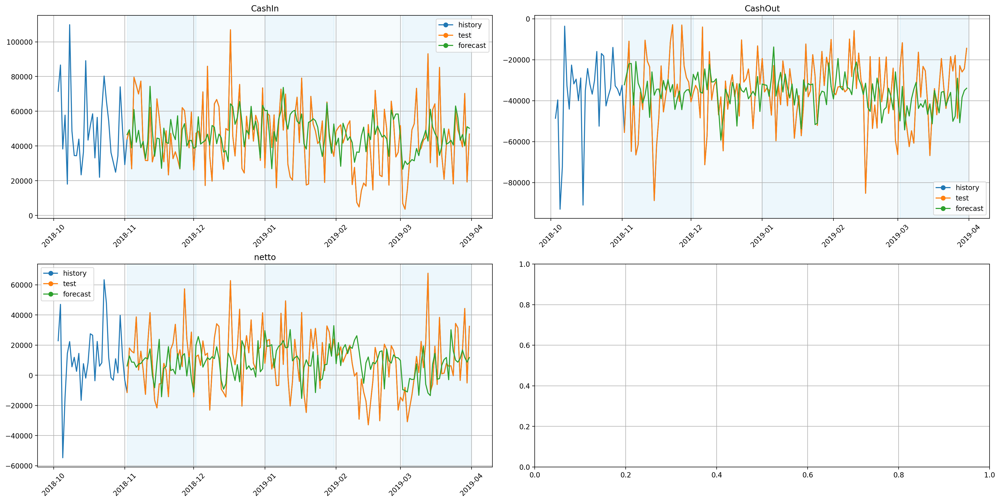

In [178]:
plot_backtest(forecast_ensemble_df_2, ts_no_nans, history_len=30)

In [181]:
# добавление очередной строки с характеристиками метода
df_metrics.loc['Dirrec (CatBoost)'] = [
    14747.122471,
    13690.526604,
    16084.110304,
    36.027593,
    40.932024,
    113.158253
]

Визуально результаты работы **Dirrec** кажутся самыми лучшими. Но из-за особенности модели пришлось увеличить горизонт предсказания.

#### Рекурсивная стратегия

**CatBoost**

In [182]:
# model_catboost = CatBoostModelPerSegment()
model_catboost = CatBoostMultiSegmentModel()

transforms_catboost = [
    DensityOutliersTransform(in_column="target", **best_params),
    TimeSeriesImputerTransform(in_column="target", strategy="seasonal", window=14, seasonality=90),
    STLTransform(in_column="target", period=30, model="arima"),
    LagTransform(in_column="target", lags=days_ctbst, out_column="target_lag"),
    MeanTransform(in_column="target", window=14)
]

autoregressivepipeline_ctb = AutoRegressivePipeline(
    model=model_catboost, transforms=transforms_catboost, horizon=HORIZON, step=1  # 3, 4 дают такой же результат
)

In [183]:
metrics_recursive_df_ctb, forecast_recursive_df_ctb, _ = autoregressivepipeline_ctb.backtest(
    ts=ts_no_nans, metrics=[SMAPE(), MAE()], aggregate_metrics=True
)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   11.5s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:   21.6s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:   35.2s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:   47.5s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:   58.2s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:   58.2s finished


In [185]:
metrics_recursive_df_ctb

,segment,SMAPE,MAE
0,CashIn,58.227032,24282.459109
1,CashOut,38.202586,13622.696977
2,netto,140.195565,21870.162616


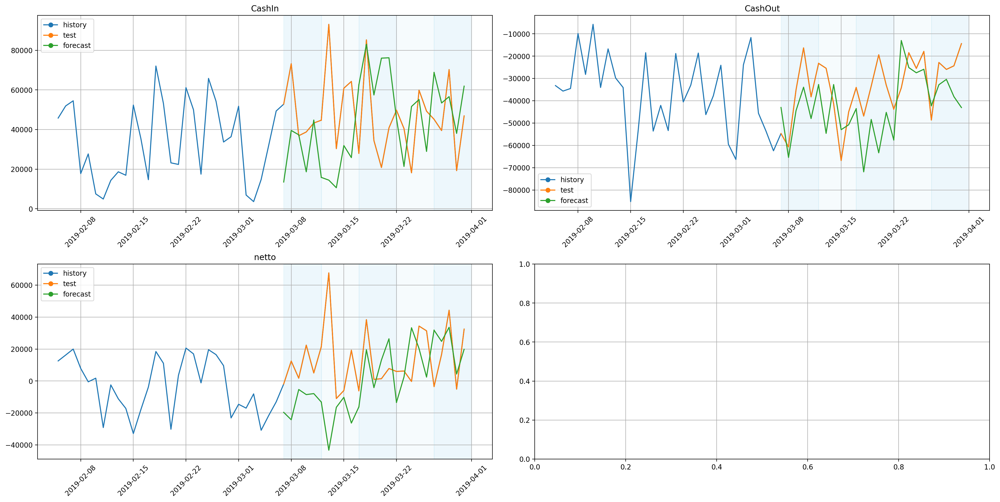

In [186]:
plot_backtest(forecast_recursive_df_ctb, ts_no_nans, history_len=30)

In [189]:
# добавление очередной строки с характеристиками метода
df_metrics.loc['CatBoost (recursive)'] = [
    24282.459109,
    13622.696977,
    21870.162616,
    58.227032,
    38.202586,
    140.195565
]

**Модель ARIMA**

In [191]:
# те же самые преобразования
model_arima = AutoARIMAModel()

transforms_arima = [
    DensityOutliersTransform(in_column="target", **best_params),
    TimeSeriesImputerTransform(in_column="target", strategy="seasonal", window=14, seasonality=90),
    LagTransform(in_column="target", lags=days_arima, out_column="target_lag"),
    LinearTrendTransform(in_column="target"),
    SegmentEncoderTransform(),
    DateFlagsTransform(
        day_number_in_week=True,
        day_number_in_month=True,
        week_number_in_month=True,
        week_number_in_year=True,
        month_number_in_year=True,
        year_number=True,
        is_weekend=True,
        special_days_in_week=[5, 6]
    ),
    HolidayTransform(iso_code="TR", out_column="TR_holidays")
]

autoregressivepipeline_arima = AutoRegressivePipeline(
    model=model_arima, transforms=transforms_arima, horizon=HORIZON, step=5  # работает только с шагом 5
)

In [192]:
metrics_recursive_df_ar, forecast_recursive_df_ar, _ = autoregressivepipeline_arima.backtest(
    ts=ts_no_nans, metrics=[SMAPE(), MAE()], aggregate_metrics=True,
)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:  1.4min remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:  2.6min remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:  3.7min remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:  4.9min remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:  6.4min remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:  6.4min finished


In [193]:
metrics_recursive_df_ar

,segment,SMAPE,MAE
0,CashIn,32.754236,14763.830974
1,CashOut,28.858670,9610.657294
2,netto,127.009690,15042.279986


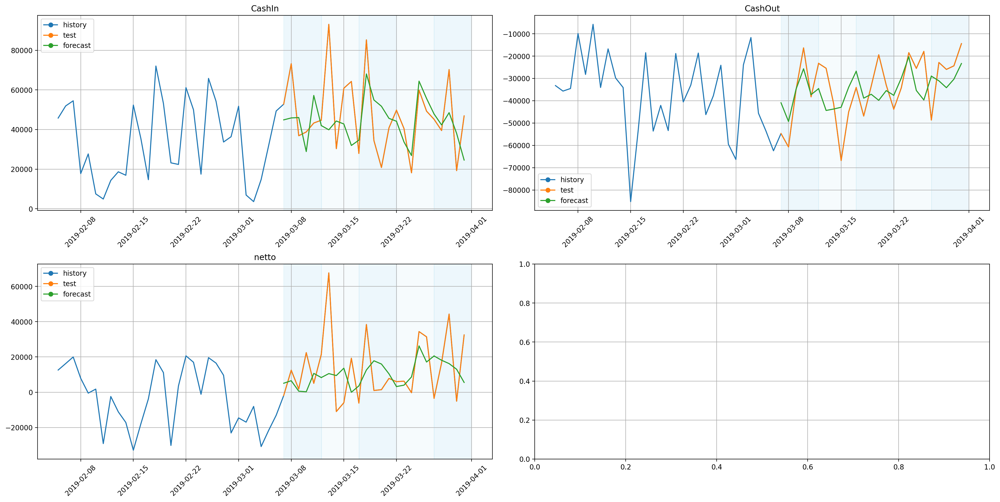

In [194]:
plot_backtest(forecast_recursive_df_ar, ts_no_nans, history_len=30)

In [197]:
# добавление очередной строки с характеристиками метода
df_metrics.loc['ARIMA (recursive)'] = [
    14763.830974,
    9610.657294,
    15042.279986,
    32.754236,
    28.858670,
    127.009690
]

**Prophet Model**

In [199]:
model_prophet = ProphetModel(daily_seasonality=True)  # daily_seasonality=True выставлено, чтобы избежать предупреждений во время работы модели

transforms_prophet = [outliers_remover, outliers_imputer]

autoregressivepipeline_prophet = AutoRegressivePipeline(
    model=model_prophet, transforms=transforms_prophet, horizon=HORIZON, step=1  # результаты ProphetModel не зависят от step
)

In [200]:
metrics_recursive_df_prophet, forecast_recursive_df_prophet, _ = autoregressivepipeline_prophet.backtest(
    ts=ts_no_nans, metrics=[SMAPE(), MAE()], aggregate_metrics=True
)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   25.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:   48.6s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:  1.2min remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:  1.8min remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:  2.2min remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:  2.2min finished


In [201]:
metrics_recursive_df_prophet

,segment,SMAPE,MAE
0,CashIn,30.960792,14318.624810
1,CashOut,34.628624,11670.941561
2,netto,133.422028,15207.236756


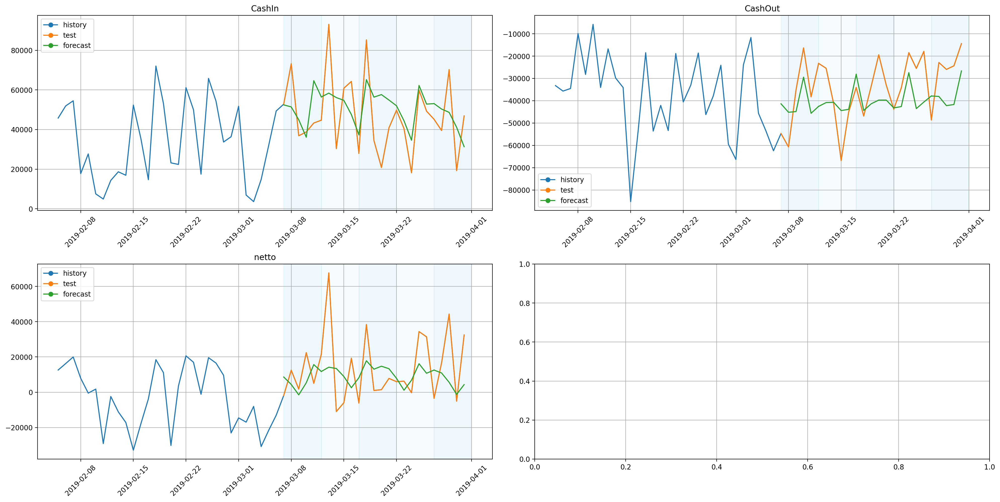

In [202]:
plot_backtest(forecast_recursive_df_prophet, ts_no_nans, history_len=30)

Результаты `ProphetModel` не отличаются при прямой и рекурсивных стратегиях.

In [204]:
df_metrics  # подытог

,MAE (CV) - CashIn,MAE (CV) - CashOut,MAE (CV) - netto,SMAPE (CV) - CashIn,SMAPE (CV) - CashOut,SMAPE (CV) - netto
ProphetModel (multiseg),14318.624810,11670.941561,15207.236756,30.960792,34.628624,133.422028
ProphetModel (hierarhical),NaN,NaN,15206.247936,NaN,NaN,128.952013
ARIMA (not CV),13680.519354,10184.759754,19717.430670,35.500132,35.494859,128.588331
ARIMA (small & not CV),17953.267776,29857.549521,7176.096492,47.081642,159.868295,43.064346
CatBoostMultiSegmentModel (not CV),17338.756156,14157.010209,10978.261584,36.831723,42.880476,62.630438
CatBoostMultiSegmentModel,23707.099681,18392.215722,19310.674689,54.699895,47.160823,132.982272
ARIMA,14630.901397,9653.281032,14534.611797,32.485425,28.653964,122.195501
Dirrec (CatBoost),14747.122471,13690.526604,16084.110304,36.027593,40.932024,113.158253
CatBoost (recursive),24282.459109,13622.696977,21870.162616,58.227032,38.202586,140.195565
ARIMA (recursive),14763.830974,9610.657294,15042.279986,32.754236,28.858670,127.009690


**Итог:** больше всего понравилась работа **смешанной стратегии** `Dirrec` с `Catboost`. Она позволяет хорошо настраивать модель.

По метрикам себя хорошо показала `ARIMA` с **прямой стратегией**, но визуально ее работа не понравилась: она выдает что-то усредненное, в то время как нашим данным свойственна большая амплитуда. Хотя, возможно, для production лучше, когда модель ведет себя стабильнее.

### Ансамбли

Чтобы не выбирать лучшую модель, мы можем использовать преимущества каждой — попробуем объединить все наработки в ансамбль. 
Попробуем различные опции ансамблирования, и выберем ту, которая работает лучше всего.

In [205]:
from etna.ensembles import StackingEnsemble, VotingEnsemble

#### `VotingEnsemble`
Определим пайплайны базовых моделей и протестируем их на кросс-валидации, чтобы определить веса для итогового ансамбля `VotingEnsemble`:

In [206]:
### ARIMA model
model_arima_hard = AutoARIMAModel()

transforms_arima_hard = [
    DensityOutliersTransform(in_column="target", **best_params),
    TimeSeriesImputerTransform(in_column="target", strategy="seasonal", window=14, seasonality=90),
    LagTransform(in_column="target", lags=days_arima_pipeline, out_column="target_lag"),
    LinearTrendTransform(in_column="target"),
    SegmentEncoderTransform(),
    DateFlagsTransform(
        day_number_in_week=True,
        day_number_in_month=True,
        week_number_in_month=True,
        week_number_in_year=True,
        month_number_in_year=True,
        year_number=True,
        is_weekend=True,
        special_days_in_week=[5, 6]
    ),
    HolidayTransform(iso_code="TR", out_column="TR_holidays")
]
pipeline_arima_hard = Pipeline(
    model=model_arima_hard, transforms=transforms_arima_hard, horizon=HORIZON
)

### catboost 1 CatBoostMultiSegmentModel

transforms_cb1 = [
    STLTransform(in_column="target", period=30, model="arima"),
    LagTransform(in_column="target", lags=days_ctbst),
    MeanTransform(in_column="target", window=14),
    HolidayTransform(iso_code="TR", out_column="TR_holidays")
]

model_catboost1 = CatBoostMultiSegmentModel()
pipeline_cb1 = Pipeline(
    model=model_catboost1, transforms=transforms_cb1, horizon=HORIZON
)

### catboost 2 CatBoostModelPerSegment

transforms_cb2 = [
    STLTransform(in_column="target", period=30, model="arima"),
    LagTransform(in_column="target", lags=days_ctbst),
    MeanTransform(in_column="target", window=14),
    HolidayTransform(iso_code="TR", out_column="TR_holidays")
]

model_catboost2 = CatBoostModelPerSegment()
pipeline_cb2 = Pipeline(
    model=model_catboost2, transforms=transforms_cb2, horizon=HORIZON
)

### catboost autoreg

model_catboost_autoreg = CatBoostMultiSegmentModel()

transforms_catboost_autoreg = [
    DensityOutliersTransform(in_column="target", **best_params),
    TimeSeriesImputerTransform(in_column="target", strategy="seasonal", window=14, seasonality=90),
    STLTransform(in_column="target", period=30, model="arima"),
    LagTransform(in_column="target", lags=days_ctbst, out_column="target_lag"),
    MeanTransform(in_column="target", window=14)
]
autoregressivepipeline_ctb = AutoRegressivePipeline(
    model=model_catboost_autoreg, transforms=transforms_catboost_autoreg, horizon=HORIZON, step=1  # 3, 4 норм
)

### ProphetModel

model_prophet = ProphetModel(daily_seasonality=True)
transforms_prophet = [outliers_remover, outliers_imputer]
pipeline_prophet = Pipeline(model=model_prophet, transforms=transforms_prophet, horizon=HORIZON)

# все пайплайны и их названия
pipeline_names = ["arima_hard", "catboost1", "catboost2", 'autoregressive_catboost', 'prophet']
pipelines = [pipeline_arima_hard, pipeline_cb1, pipeline_cb2, autoregressivepipeline_ctb, pipeline_prophet]

In [207]:
from IPython.display import clear_output

metrics = []
for pipeline in pipelines:
    metrics.append(
        pipeline.backtest(
            ts=ts_no_nans,
            metrics=[MAE(), SMAPE()],
            aggregate_metrics=True
        )[0].iloc[:, 1:]
    )

    clear_output()

In [208]:
# объединим метрики в датафрейм, чтобы определить веса для ансамбля
metrics = pd.concat(metrics)

# MAE
metrics_df_mae = pd.DataFrame(
    {'CashIn': metrics.loc[0]['MAE'].to_list(),
     'CashOut': metrics.loc[1]['MAE'].to_list(),
     'netto': metrics.loc[2]['MAE'].to_list()}
)
metrics_df_mae.index = pipeline_names
# доли моделей в общей ошибке
metrics_df_mae['ratio'] = metrics_df_mae['netto'] / np.sum(metrics_df_mae['netto']) * 100

# SMAPE
metrics_df_smape = pd.DataFrame(
    {'CashIn': metrics.loc[0]['SMAPE'].to_list(),
     'CashOut': metrics.loc[1]['SMAPE'].to_list(),
     'netto': metrics.loc[2]['SMAPE'].to_list()}
)
metrics_df_smape.index = pipeline_names
# доли моделей в общей ошибке
metrics_df_smape['ratio'] = metrics_df_smape['netto'] / np.sum(metrics_df_smape['netto']) * 100

Посмотрим на получившиеся метрики моделей: 

In [209]:
metrics_df_mae

,CashIn,CashOut,netto,ratio
arima_hard,14630.901397,9653.281032,14534.611797,15.978338
catboost1,24093.989369,17906.719364,19439.601928,21.370542
catboost2,23360.474722,17353.040152,19912.864335,21.890814
autoregressive_catboost,24282.459109,13622.696977,21870.162616,24.042531
prophet,14318.624810,11670.941561,15207.236756,16.717775


In [210]:
metrics_df_smape

,CashIn,CashOut,netto,ratio
arima_hard,32.485425,28.653964,122.195501,18.258519
catboost1,55.538290,46.625335,136.821745,20.443980
catboost2,58.518169,44.359275,136.617149,20.413409
autoregressive_catboost,58.227032,38.202586,140.195565,20.948098
prophet,30.960792,34.628624,133.422028,19.935993


Усредним «скор» (чем меньше доля — тем лучше):

In [211]:
(metrics_df_mae['ratio'] + metrics_df_smape['ratio']) / 2

arima_hard                 17.118429
catboost1                  20.907261
catboost2                  21.152112
autoregressive_catboost    22.495315
prophet                    18.326884
Name: ratio, dtype: float64

In [222]:
# w = [22.49531469, 20.90726121, 18.32688395, 17.11842854, 21.15211162]  # можно задать веса на основе усредненных метрик выше
# предлагаю задать их проще:
w = [11, 8, 6, 5, 8]

In [223]:
# voting_ensemble = VotingEnsemble(pipelines=pipelines, weights=[1, 1, 1, 1, 1], n_jobs=-1)  # ансамбль с одинаковыми весами
voting_ensemble = VotingEnsemble(pipelines=pipelines, weights=w, n_jobs=-1)

In [224]:
voting_ensamble_metrics, voting_ensamble_forecast, _ = voting_ensemble.backtest(
    ts=ts_no_nans,
    metrics=[MAE(), SMAPE()],
    aggregate_metrics=True,
    n_jobs=-1,
)

[Parallel(n_jobs=-1)]: Using backend MultiprocessingBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:  3.0min
[Parallel(n_jobs=-1)]: Done   2 out of   5 | elapsed:  3.1min remaining:  4.7min
[Parallel(n_jobs=-1)]: Done   3 out of   5 | elapsed:  3.3min remaining:  2.2min
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:  3.3min remaining:    0.0s
[Parallel(n_jobs=-1)]: Done   5 out of   5 | elapsed:  3.3min finished


In [217]:
voting_ensamble_metrics

,segment,MAE,SMAPE
0,CashIn,16806.270391,36.947291
1,CashOut,12300.159101,35.441225
2,netto,16002.436515,138.060951


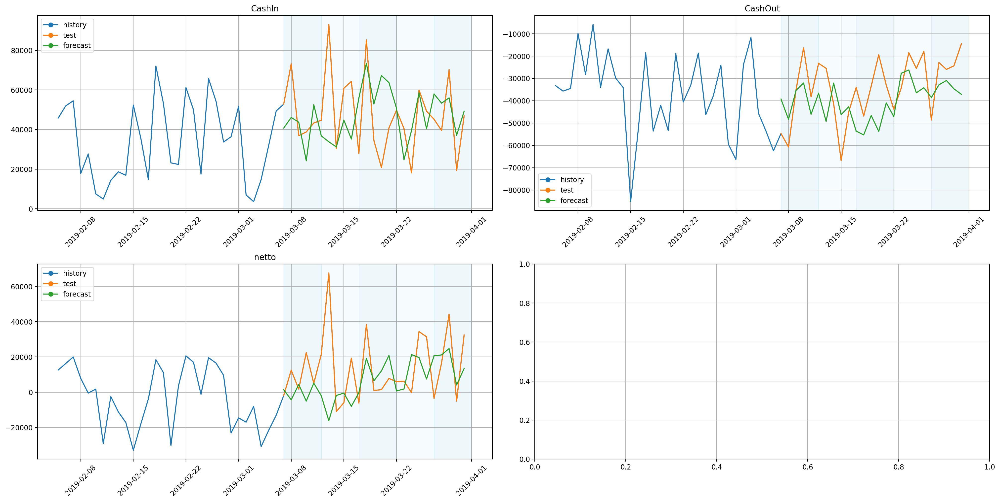

In [218]:
plot_backtest(voting_ensamble_forecast, ts_no_nans, history_len=30)

In [221]:
# добавление очередной строки с характеристиками метода
df_metrics.loc['VotingEnsemble (ARIMA+CatBoost(x2)+CatBoost(recursive)+Prophet)'] = [
    16806.270391,
    12300.159101,
    16002.436515,
    36.947291,
    35.441225,
    138.060951
]

Были опробованы разные веса для моделей, но получить метрики лучше не получилось. 

#### `StackingEnsemble`

In [226]:
### CatBoost 1 CatBoostMultiSegmentModel

transforms_cb1 = [
    STLTransform(in_column="target", period=30, model="arima"),
    LagTransform(in_column="target", lags=days_ctbst),
    MeanTransform(in_column="target", window=14),
    HolidayTransform(iso_code="TR", out_column="TR_holidays")
]

model_catboost1 = CatBoostMultiSegmentModel()
pipeline_cb1 = Pipeline(
    model=model_catboost1, transforms=transforms_cb1, horizon=HORIZON
)

### CatBoost 2 CatBoostModelPerSegment

transforms_cb2 = [
    STLTransform(in_column="target", period=30, model="arima"),
    LagTransform(in_column="target", lags=days_ctbst),
    MeanTransform(in_column="target", window=14),
    HolidayTransform(iso_code="TR", out_column="TR_holidays")
]

model_catboost2 = CatBoostModelPerSegment()
pipeline_cb2 = Pipeline(
    model=model_catboost2, transforms=transforms_cb2, horizon=HORIZON
)


### CatBoost autoreg

model_catboost_autoreg = CatBoostMultiSegmentModel()

transforms_catboost_autoreg = [
    DensityOutliersTransform(in_column="target", **best_params),
    TimeSeriesImputerTransform(in_column="target", strategy="seasonal", window=14, seasonality=90),
    STLTransform(in_column="target", period=30, model="arima"),
    LagTransform(in_column="target", lags=days_ctbst, out_column="target_lag"),
    MeanTransform(in_column="target", window=14)
]

autoregressivepipeline_ctb = AutoRegressivePipeline(
    model=model_catboost_autoreg, transforms=transforms_catboost_autoreg, horizon=HORIZON, step=1
)

### ProphetModel
model_prophet = ProphetModel(daily_seasonality=True)
transforms_prophet = [outliers_remover, outliers_imputer]
pipeline_prophet = Pipeline(model=model_prophet, transforms=transforms_prophet, horizon=HORIZON)

pipeline_names = ["catboost1", "catboost2", 'autoregressive_catboost', 'prophet']
pipelines = [pipeline_cb1, pipeline_cb2, autoregressivepipeline_ctb, pipeline_prophet]

In [251]:
stacking_ensemble_unfeatured = StackingEnsemble(
    pipelines=pipelines, n_folds=5, features_to_use=None  # использование features_to_use='all' вызывает ошибку
)

In [252]:
stacking_ensamble_metrics, stacking_ensamble_forecast, _ = stacking_ensemble_unfeatured.backtest(
    ts=ts_no_nans,
    metrics=[MAE(), SMAPE()],
    n_folds=5,
    aggregate_metrics=True
)


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    8.4s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | elapsed:   17.6s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   3 out of   3 | elapsed:   27.7s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   4 out of   4 | elapsed:   38.8s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:   49.2s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   5 out of   5 | elapsed:   49.2s finished
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   49.3s remaining:    0.0s
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   23.1s remaining:    0.0s
[Parallel(n_jobs=1)]: Done   2 out of   2 | el

In [253]:
stacking_ensamble_metrics

,segment,MAE,SMAPE
0,CashIn,15705.034187,36.240886
1,CashOut,11317.056818,35.759661
2,netto,16644.578081,148.572101


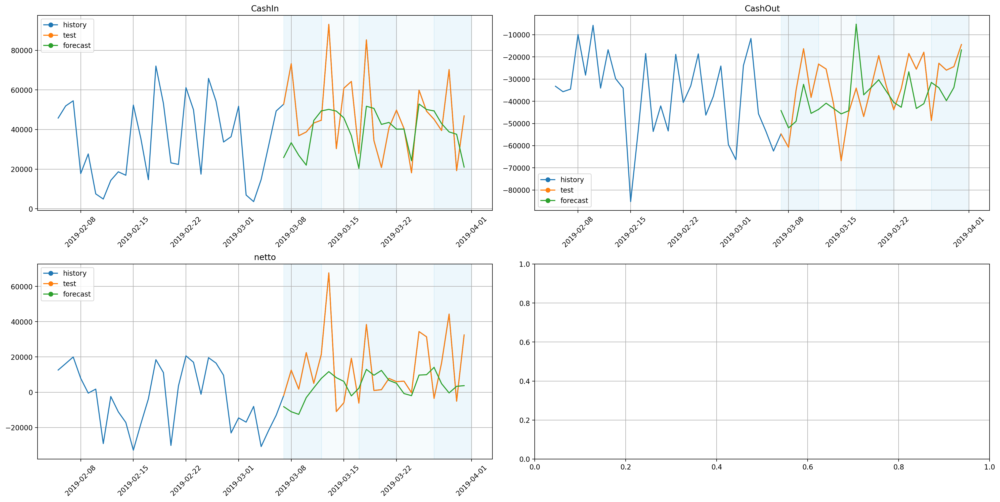

In [254]:
plot_backtest(stacking_ensamble_forecast, ts_no_nans, history_len=30)

In [257]:
# добавление очередной строки с характеристиками метода
df_metrics.loc['StackingEnsemble (CatBoost(x2)+CatBoost(recursive)+Prophet)'] = [
    15705.034187,
    11317.056818,
    16644.578081,
    36.240886,
    35.759661,
    148.572101
]

Говоря об ансамблях моделей, оба показали себя не лучшим образом на целевом сегменте, но неплохо на сегментах `CashIn` и `CashOut`. Однако, хотя метрики на целевом сегменте плохие, визуально мне нравятся их предсказания больше, чем у некоторых моделей, получивших лучший скор. Им совсем немного не хватает амплитуды, но они хорошо показывают тренд и сезонность.

Однако важно отметить, что `StackingEnsemble` училась около 20 минут — дольше всех в этой работе. `VotingEnsemble` училась достаточно быстро (около 3 мин.).

### Итог

Посмотрим на метрики, полученные всеми моделями и ансамблями в этой работе:

In [258]:
df_metrics.sort_values(['MAE (CV) - netto'])

,MAE (CV) - CashIn,MAE (CV) - CashOut,MAE (CV) - netto,SMAPE (CV) - CashIn,SMAPE (CV) - CashOut,SMAPE (CV) - netto
ARIMA (small & not CV),17953.267776,29857.549521,7176.096492,47.081642,159.868295,43.064346
CatBoostMultiSegmentModel (not CV),17338.756156,14157.010209,10978.261584,36.831723,42.880476,62.630438
ARIMA,14630.901397,9653.281032,14534.611797,32.485425,28.653964,122.195501
ARIMA (recursive),14763.830974,9610.657294,15042.279986,32.754236,28.858670,127.009690
ProphetModel (hierarhical),NaN,NaN,15206.247936,NaN,NaN,128.952013
ProphetModel (multiseg),14318.624810,11670.941561,15207.236756,30.960792,34.628624,133.422028
VotingEnsemble (ARIMA+CatBoost(x2)+CatBoost(recursive)+Prophet),16806.270391,12300.159101,16002.436515,36.947291,35.441225,138.060951
Dirrec (CatBoost),14747.122471,13690.526604,16084.110304,36.027593,40.932024,113.158253
StackingEnsemble (CatBoost(x2)+CatBoost(recursive)+Prophet),15705.034187,11317.056818,16644.578081,36.240886,35.759661,148.572101
CatBoostMultiSegmentModel,23707.099681,18392.215722,19310.674689,54.699895,47.160823,132.982272


In [259]:
df_metrics.sort_values(['SMAPE (CV) - netto'])

,MAE (CV) - CashIn,MAE (CV) - CashOut,MAE (CV) - netto,SMAPE (CV) - CashIn,SMAPE (CV) - CashOut,SMAPE (CV) - netto
ARIMA (small & not CV),17953.267776,29857.549521,7176.096492,47.081642,159.868295,43.064346
CatBoostMultiSegmentModel (not CV),17338.756156,14157.010209,10978.261584,36.831723,42.880476,62.630438
Dirrec (CatBoost),14747.122471,13690.526604,16084.110304,36.027593,40.932024,113.158253
ARIMA,14630.901397,9653.281032,14534.611797,32.485425,28.653964,122.195501
ARIMA (recursive),14763.830974,9610.657294,15042.279986,32.754236,28.858670,127.009690
ARIMA (not CV),13680.519354,10184.759754,19717.430670,35.500132,35.494859,128.588331
ProphetModel (hierarhical),NaN,NaN,15206.247936,NaN,NaN,128.952013
CatBoostMultiSegmentModel,23707.099681,18392.215722,19310.674689,54.699895,47.160823,132.982272
ProphetModel (multiseg),14318.624810,11670.941561,15207.236756,30.960792,34.628624,133.422028
VotingEnsemble (ARIMA+CatBoost(x2)+CatBoost(recursive)+Prophet),16806.270391,12300.159101,16002.436515,36.947291,35.441225,138.060951


Лучшие метрики набрала модель `ARIMA`, обученная не на всем датасете, однако она не была протестирована на кросс-валидации — только на тестовой выборке — поэтому ее метрика не сравнима напрямую с остальными моделями.

Если говорить про модели, которые были пропущены через кросс-валидацию, хороший результат получила модель со смешанной стратегией предсказания `Dirrec` на основе двух разных моделей град. бустинга `CatBoost`. Лично мне визуально ее предсказания понравились больше всех.

Формально хорошие результаты показала модель `ARIMA`, но визуально ее предсказания слабо отличаются друг от друга от недели к неделе. Думаю, что она получила хороший скор, потому что давала «усредненные» прогнозы, что не всегда хорошо в реальной работе в ML. Аналогично можно сказать про `ProphetModel`, для нее это еще более ярковыраженно.
В особенности, в отношении `ARIMA` не понравилось то, что она часто выдавала ошибки на некоторых лагах без какой-либо логической связи. Причем при разных пайплайнах ошибки были на разных лагах (иногда 7 и 14, а иногда 30 или 365). Из-за этого осталось ощущение, что `ARIMA` могла показать себя лучше при сохранении всех выявленных лагов.

Ансамбли моделей показали не самый лучший результат. Однако, вероятно, их нужно более тонко настраивать. К тому же, они стали единственными моделями, которые не выдавали противоположный результат на одном из последних аутлаеров, как другие модели.

В целом, можно отметить, что многие модели показали очень хорошие метрики на сегментах `CashIn` и `CashOut`. Причем, вероятно, метрики на `netto` были плохие зачастую из-за одного аутлаера, который был в рассаматриваемом периоде в конце. Также часто модели хорошо апроксимировали тренд в данных, но плохо моделировали большой разброс, поскольку данным характерно наличие большого шума.

Итак, если бы я выбирал из всех моделей ту, которую нужно внедрить в production, я бы остановился на `Dirrec` на основе `CatBoost` или на `ARIMA`, обученной не на всем датасете с небольшими лагами. Однако мне крайне не понравилось то, как `ARIMA` реализована в библиотеке `etna`.